# Here we estimate the price of house 

## Bussiness Case:- 
* 
House Price Prediction Systems use historical real estate data to provide accurate, data-driven property valuations, transforming the traditional real estate market. These systems help buyers, sellers, and investors make informed decisions by analyzing factors like location, size, and market trends. By leveraging machine learning models, they offer faster and more transparent pricing, while the data generated can also detect shifts in the housing market, providing valuable insights into economic and regional trends. This makes house price prediction systems a crucial tool in the evolving real estate landscape.

# Domain Analysis

In [4]:
# import total python liabrary for this project
import numpy as np # use for numerical function
import pandas as pd # use for data cleaning and data analysis
import matplotlib.pyplot as plt # use data visualize
import seaborn as sns # use for data visualize
import warnings # use for the warnings ignore
warnings.filterwarnings('ignore') # call the warning

In [5]:
df=pd.read_csv("HousePricePrediction.csv") # Load the dataset

In [6]:
df 

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,1,60,RL,65.0,8450,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,NaN,NaN,0,2,2008,WD,Normal,208500
1,2,20,RL,80.0,9600,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,NaN,NaN,0,5,2007,WD,Normal,181500
2,3,60,RL,68.0,11250,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,9,2008,WD,Normal,223500
3,4,70,RL,60.0,9550,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,2,2006,WD,Abnorml,140000
4,5,60,RL,84.0,14260,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,12,2008,WD,Normal,250000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1455,1456,60,RL,62.0,7917,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,NaN,NaN,0,8,2007,WD,Normal,175000
1456,1457,20,RL,85.0,13175,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,MnPrv,NaN,0,2,2010,WD,Normal,210000
1457,1458,70,RL,66.0,9042,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,GdPrv,Shed,2500,5,2010,WD,Normal,266500
1458,1459,20,RL,68.0,9717,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,NaN,NaN,0,4,2010,WD,Normal,142125


In [7]:
df.head() # showing first 5 rows

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,1,60,RL,65.0,8450,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,NaN,NaN,0,2,2008,WD,Normal,208500
1,2,20,RL,80.0,9600,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,NaN,NaN,0,5,2007,WD,Normal,181500
2,3,60,RL,68.0,11250,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,9,2008,WD,Normal,223500
3,4,70,RL,60.0,9550,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,2,2006,WD,Abnorml,140000
4,5,60,RL,84.0,14260,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,12,2008,WD,Normal,250000


In [8]:
df.tail() # showing last 5 rows

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
1455,1456,60,RL,62.0,7917,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,NaN,NaN,0,8,2007,WD,Normal,175000
1456,1457,20,RL,85.0,13175,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,MnPrv,NaN,0,2,2010,WD,Normal,210000
1457,1458,70,RL,66.0,9042,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,GdPrv,Shed,2500,5,2010,WD,Normal,266500
1458,1459,20,RL,68.0,9717,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,NaN,NaN,0,4,2010,WD,Normal,142125
1459,1460,20,RL,75.0,9937,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,NaN,NaN,0,6,2008,WD,Normal,147500


In [9]:
pd.set_option("display.max_columns",None) # For all display columns

In [10]:
df.head() # showing first 5 rows

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,1,60,RL,65.0,8450,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2003,2003,Gable,CompShg,VinylSd,VinylSd,BrkFace,196.0,Gd,TA,PConc,Gd,TA,No,GLQ,706,Unf,0,150,856,GasA,Ex,Y,SBrkr,856,854,0,1710,1,0,2,1,3,1,Gd,8,Typ,0,NaN,Attchd,2003.0,RFn,2,548,TA,TA,Y,0,61,0,0,0,0,NaN,NaN,NaN,0,2,2008,WD,Normal,208500
1,2,20,RL,80.0,9600,Pave,NaN,Reg,Lvl,AllPub,FR2,Gtl,Veenker,Feedr,Norm,1Fam,1Story,6,8,1976,1976,Gable,CompShg,MetalSd,MetalSd,NaN,0.0,TA,TA,CBlock,Gd,TA,Gd,ALQ,978,Unf,0,284,1262,GasA,Ex,Y,SBrkr,1262,0,0,1262,0,1,2,0,3,1,TA,6,Typ,1,TA,Attchd,1976.0,RFn,2,460,TA,TA,Y,298,0,0,0,0,0,NaN,NaN,NaN,0,5,2007,WD,Normal,181500
2,3,60,RL,68.0,11250,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2001,2002,Gable,CompShg,VinylSd,VinylSd,BrkFace,162.0,Gd,TA,PConc,Gd,TA,Mn,GLQ,486,Unf,0,434,920,GasA,Ex,Y,SBrkr,920,866,0,1786,1,0,2,1,3,1,Gd,6,Typ,1,TA,Attchd,2001.0,RFn,2,608,TA,TA,Y,0,42,0,0,0,0,NaN,NaN,NaN,0,9,2008,WD,Normal,223500
3,4,70,RL,60.0,9550,Pave,NaN,IR1,Lvl,AllPub,Corner,Gtl,Crawfor,Norm,Norm,1Fam,2Story,7,5,1915,1970,Gable,CompShg,Wd Sdng,Wd Shng,NaN,0.0,TA,TA,BrkTil,TA,Gd,No,ALQ,216,Unf,0,540,756,GasA,Gd,Y,SBrkr,961,756,0,1717,1,0,1,0,3,1,Gd,7,Typ,1,Gd,Detchd,1998.0,Unf,3,642,TA,TA,Y,0,35,272,0,0,0,NaN,NaN,NaN,0,2,2006,WD,Abnorml,140000
4,5,60,RL,84.0,14260,Pave,NaN,IR1,Lvl,AllPub,FR2,Gtl,NoRidge,Norm,Norm,1Fam,2Story,8,5,2000,2000,Gable,CompShg,VinylSd,VinylSd,BrkFace,350.0,Gd,TA,PConc,Gd,TA,Av,GLQ,655,Unf,0,490,1145,GasA,Ex,Y,SBrkr,1145,1053,0,2198,1,0,2,1,4,1,Gd,9,Typ,1,TA,Attchd,2000.0,RFn,3,836,TA,TA,Y,192,84,0,0,0,0,NaN,NaN,NaN,0,12,2008,WD,Normal,250000


In [11]:
df.tail() # showing last 5 rows

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
1455,1456,60,RL,62.0,7917,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,Gilbert,Norm,Norm,1Fam,2Story,6,5,1999,2000,Gable,CompShg,VinylSd,VinylSd,NaN,0.0,TA,TA,PConc,Gd,TA,No,Unf,0,Unf,0,953,953,GasA,Ex,Y,SBrkr,953,694,0,1647,0,0,2,1,3,1,TA,7,Typ,1,TA,Attchd,1999.0,RFn,2,460,TA,TA,Y,0,40,0,0,0,0,NaN,NaN,NaN,0,8,2007,WD,Normal,175000
1456,1457,20,RL,85.0,13175,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,NWAmes,Norm,Norm,1Fam,1Story,6,6,1978,1988,Gable,CompShg,Plywood,Plywood,Stone,119.0,TA,TA,CBlock,Gd,TA,No,ALQ,790,Rec,163,589,1542,GasA,TA,Y,SBrkr,2073,0,0,2073,1,0,2,0,3,1,TA,7,Min1,2,TA,Attchd,1978.0,Unf,2,500,TA,TA,Y,349,0,0,0,0,0,NaN,MnPrv,NaN,0,2,2010,WD,Normal,210000
1457,1458,70,RL,66.0,9042,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,Crawfor,Norm,Norm,1Fam,2Story,7,9,1941,2006,Gable,CompShg,CemntBd,CmentBd,NaN,0.0,Ex,Gd,Stone,TA,Gd,No,GLQ,275,Unf,0,877,1152,GasA,Ex,Y,SBrkr,1188,1152,0,2340,0,0,2,0,4,1,Gd,9,Typ,2,Gd,Attchd,1941.0,RFn,1,252,TA,TA,Y,0,60,0,0,0,0,NaN,GdPrv,Shed,2500,5,2010,WD,Normal,266500
1458,1459,20,RL,68.0,9717,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,NAmes,Norm,Norm,1Fam,1Story,5,6,1950,1996,Hip,CompShg,MetalSd,MetalSd,NaN,0.0,TA,TA,CBlock,TA,TA,Mn,GLQ,49,Rec,1029,0,1078,GasA,Gd,Y,FuseA,1078,0,0,1078,1,0,1,0,2,1,Gd,5,Typ,0,NaN,Attchd,1950.0,Unf,1,240,TA,TA,Y,366,0,112,0,0,0,NaN,NaN,NaN,0,4,2010,WD,Normal,142125
1459,1460,20,RL,75.0,9937,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,Edwards,Norm,Norm,1Fam,1Story,5,6,1965,1965,Gable,CompShg,HdBoard,HdBoard,NaN,0.0,Gd,TA,CBlock,TA,TA,No,BLQ,830,LwQ,290,136,1256,GasA,Gd,Y,SBrkr,1256,0,0,1256,1,0,1,1,3,1,TA,6,Typ,0,NaN,Attchd,1965.0,Fin,1,276,TA,TA,Y,736,68,0,0,0,0,NaN,NaN,NaN,0,6,2008,WD,Normal,147500


### Atribute Information:-
**SalePrice:-** the property's sale price in dollars. This is the target variable that we're trying to predict.\
**MSSubClass:-** The building class\
**MSZoning:-** The general zoning classification\
**LotFrontage:-** Linear feet of street connected to property\
**LotArea:-** Lot size in square feet\
**Street:=** Type of road access\
**Alley:=** Type of alley access\
**LotShape:-** General shape of property\
**LandContour:-** Flatness of the property\
**Utilities:-** Type of utilities available\
**LotConfig:-** Lot configuration\
**LandSlope:-** Slope of property\
**Neighborhood:-** Physical locations within Ames city limits\
**Condition1:-** Proximity to main road or railroad\
**Condition2:-** Proximity to main road or railroad (if a second is present)\
**BldgType:-** Type of dwelling\
**HouseStyle:-** Style of dwelling\
**OverallQual:-** Overall material and finish quality\
**OverallCond:-** Overall condition rating\
**YearBuilt:-** Original construction date\
**YearRemodAdd:-** Remodel date\
**RoofStyle:-** Type of roof\
**RoofMatl:-** Roof material\
**Exterior1st:-** Exterior covering on house\
**Exterior2nd:-** Exterior covering on house (if more than one material)\
**MasVnrType:-** Masonry veneer type\
**MasVnrArea:-** Masonry veneer area in square feet\
**ExterQual:-** Exterior material quality\
**ExterCond:-** Present condition of the material on the exterior\
**Foundation:-** Type of foundation\
**BsmtQual:-** Height of the basement\
**BsmtCond:-** General condition of the basement\
**BsmtExposure:-** Walkout or garden level basement walls\
**BsmtFinType1:-** Quality of basement finished area\
**BsmtFinSF1:-** Type 1 finished square feet\
**BsmtFinType2:-** Quality of second finished area (if present)\
**BsmtFinSF2:-** Type 2 finished square feet\
**BsmtUnfSF:-** Unfinished square feet of basement area\
**TotalBsmtSF:-** Total square feet of basement area\
**Heating:-** Type of heating\
**HeatingQC:-** Heating quality and condition\
**CentralAir:-** Central air conditioning\
**Electrical:-** Electrical system\
**1stFlrSF:-** First Floor square feet\
**2ndFlrSF:-** Second floor square feet\
**LowQualFinSF:-** Low quality finished square feet (all floors)\
**GrLivArea:-** Above grade (ground) living area square feet\
**BsmtFullBath:-** Basement full bathrooms\
**BsmtHalfBath:-** Basement half bathrooms\
**FullBath:-** Full bathrooms above grade\
**HalfBath:-** Half baths above grade\
**Bedroom:-** Number of bedrooms above basement level\
**Kitchen:-** Number of kitchens\
**KitchenQual:-** Kitchen quality\
**TotRmsAbvGrd:-** Total rooms above grade (does not include bathrooms)\
**Functional:-** Home functionality rating\
**Fireplaces:-** Number of fireplaces\
**FireplaceQu:-** Fireplace quality\
**GarageType:-** Garage location\
**GarageYrBlt:-** Year garage was built\
**GarageFinish:-** Interior finish of the garage\
**GarageCars:-** Size of garage in car capacity\
**GarageArea:-** Size of garage in square feet\
**GarageQual:-** Garage quality\
**GarageCond:-** Garage condition\
**PavedDrive:-** Paved driveway\
**WoodDeckSF:-** Wood deck area in square feet\
**OpenPorchSF:-** Open porch area in square feet\
**EnclosedPorch:-** Enclosed porch area in square feet\
**3SsnPorch:-** Three season porch area in square feet\
**ScreenPorch:-** Screen porch area in square feet\
**PoolArea:-** Pool area in square feet\
**PoolQC:-** Pool quality\
**Fence:-** Fence quality\
**MiscFeature:-** Miscellaneous feature not covered in other categories\
**MiscVal:-** $Value of miscellaneous feature\
**MoSold:-** Month Sold\
**YrSold:-** Year Sold\
**SaleType:-** Type of sale\
**SaleCondition:-** Condition of sale

# Basic Check

In [12]:
df.head() # showing first 5 rows of dataset

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,1,60,RL,65.0,8450,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2003,2003,Gable,CompShg,VinylSd,VinylSd,BrkFace,196.0,Gd,TA,PConc,Gd,TA,No,GLQ,706,Unf,0,150,856,GasA,Ex,Y,SBrkr,856,854,0,1710,1,0,2,1,3,1,Gd,8,Typ,0,NaN,Attchd,2003.0,RFn,2,548,TA,TA,Y,0,61,0,0,0,0,NaN,NaN,NaN,0,2,2008,WD,Normal,208500
1,2,20,RL,80.0,9600,Pave,NaN,Reg,Lvl,AllPub,FR2,Gtl,Veenker,Feedr,Norm,1Fam,1Story,6,8,1976,1976,Gable,CompShg,MetalSd,MetalSd,NaN,0.0,TA,TA,CBlock,Gd,TA,Gd,ALQ,978,Unf,0,284,1262,GasA,Ex,Y,SBrkr,1262,0,0,1262,0,1,2,0,3,1,TA,6,Typ,1,TA,Attchd,1976.0,RFn,2,460,TA,TA,Y,298,0,0,0,0,0,NaN,NaN,NaN,0,5,2007,WD,Normal,181500
2,3,60,RL,68.0,11250,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2001,2002,Gable,CompShg,VinylSd,VinylSd,BrkFace,162.0,Gd,TA,PConc,Gd,TA,Mn,GLQ,486,Unf,0,434,920,GasA,Ex,Y,SBrkr,920,866,0,1786,1,0,2,1,3,1,Gd,6,Typ,1,TA,Attchd,2001.0,RFn,2,608,TA,TA,Y,0,42,0,0,0,0,NaN,NaN,NaN,0,9,2008,WD,Normal,223500
3,4,70,RL,60.0,9550,Pave,NaN,IR1,Lvl,AllPub,Corner,Gtl,Crawfor,Norm,Norm,1Fam,2Story,7,5,1915,1970,Gable,CompShg,Wd Sdng,Wd Shng,NaN,0.0,TA,TA,BrkTil,TA,Gd,No,ALQ,216,Unf,0,540,756,GasA,Gd,Y,SBrkr,961,756,0,1717,1,0,1,0,3,1,Gd,7,Typ,1,Gd,Detchd,1998.0,Unf,3,642,TA,TA,Y,0,35,272,0,0,0,NaN,NaN,NaN,0,2,2006,WD,Abnorml,140000
4,5,60,RL,84.0,14260,Pave,NaN,IR1,Lvl,AllPub,FR2,Gtl,NoRidge,Norm,Norm,1Fam,2Story,8,5,2000,2000,Gable,CompShg,VinylSd,VinylSd,BrkFace,350.0,Gd,TA,PConc,Gd,TA,Av,GLQ,655,Unf,0,490,1145,GasA,Ex,Y,SBrkr,1145,1053,0,2198,1,0,2,1,4,1,Gd,9,Typ,1,TA,Attchd,2000.0,RFn,3,836,TA,TA,Y,192,84,0,0,0,0,NaN,NaN,NaN,0,12,2008,WD,Normal,250000


In [13]:
df.tail() # Showing last 5 rows of dataset

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
1455,1456,60,RL,62.0,7917,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,Gilbert,Norm,Norm,1Fam,2Story,6,5,1999,2000,Gable,CompShg,VinylSd,VinylSd,NaN,0.0,TA,TA,PConc,Gd,TA,No,Unf,0,Unf,0,953,953,GasA,Ex,Y,SBrkr,953,694,0,1647,0,0,2,1,3,1,TA,7,Typ,1,TA,Attchd,1999.0,RFn,2,460,TA,TA,Y,0,40,0,0,0,0,NaN,NaN,NaN,0,8,2007,WD,Normal,175000
1456,1457,20,RL,85.0,13175,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,NWAmes,Norm,Norm,1Fam,1Story,6,6,1978,1988,Gable,CompShg,Plywood,Plywood,Stone,119.0,TA,TA,CBlock,Gd,TA,No,ALQ,790,Rec,163,589,1542,GasA,TA,Y,SBrkr,2073,0,0,2073,1,0,2,0,3,1,TA,7,Min1,2,TA,Attchd,1978.0,Unf,2,500,TA,TA,Y,349,0,0,0,0,0,NaN,MnPrv,NaN,0,2,2010,WD,Normal,210000
1457,1458,70,RL,66.0,9042,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,Crawfor,Norm,Norm,1Fam,2Story,7,9,1941,2006,Gable,CompShg,CemntBd,CmentBd,NaN,0.0,Ex,Gd,Stone,TA,Gd,No,GLQ,275,Unf,0,877,1152,GasA,Ex,Y,SBrkr,1188,1152,0,2340,0,0,2,0,4,1,Gd,9,Typ,2,Gd,Attchd,1941.0,RFn,1,252,TA,TA,Y,0,60,0,0,0,0,NaN,GdPrv,Shed,2500,5,2010,WD,Normal,266500
1458,1459,20,RL,68.0,9717,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,NAmes,Norm,Norm,1Fam,1Story,5,6,1950,1996,Hip,CompShg,MetalSd,MetalSd,NaN,0.0,TA,TA,CBlock,TA,TA,Mn,GLQ,49,Rec,1029,0,1078,GasA,Gd,Y,FuseA,1078,0,0,1078,1,0,1,0,2,1,Gd,5,Typ,0,NaN,Attchd,1950.0,Unf,1,240,TA,TA,Y,366,0,112,0,0,0,NaN,NaN,NaN,0,4,2010,WD,Normal,142125
1459,1460,20,RL,75.0,9937,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,Edwards,Norm,Norm,1Fam,1Story,5,6,1965,1965,Gable,CompShg,HdBoard,HdBoard,NaN,0.0,Gd,TA,CBlock,TA,TA,No,BLQ,830,LwQ,290,136,1256,GasA,Gd,Y,SBrkr,1256,0,0,1256,1,0,1,1,3,1,TA,6,Typ,0,NaN,Attchd,1965.0,Fin,1,276,TA,TA,Y,736,68,0,0,0,0,NaN,NaN,NaN,0,6,2008,WD,Normal,147500


In [14]:
df.describe() # Shwing continuous columns information

,Id,MSSubClass,LotFrontage,LotArea,OverallQual,OverallCond,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,TotRmsAbvGrd,Fireplaces,GarageYrBlt,GarageCars,GarageArea,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SalePrice
count,1460.000000,1460.000000,1201.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1452.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1379.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000
mean,730.500000,56.897260,70.049958,10516.828082,6.099315,5.575342,1971.267808,1984.865753,103.685262,443.639726,46.549315,567.240411,1057.429452,1162.626712,346.992466,5.844521,1515.463699,0.425342,0.057534,1.565068,0.382877,2.866438,1.046575,6.517808,0.613014,1978.506164,1.767123,472.980137,94.244521,46.660274,21.954110,3.409589,15.060959,2.758904,43.489041,6.321918,2007.815753,180921.195890
std,421.610009,42.300571,24.284752,9981.264932,1.382997,1.112799,30.202904,20.645407,181.066207,456.098091,161.319273,441.866955,438.705324,386.587738,436.528436,48.623081,525.480383,0.518911,0.238753,0.550916,0.502885,0.815778,0.220338,1.625393,0.644666,24.689725,0.747315,213.804841,125.338794,66.256028,61.119149,29.317331,55.757415,40.177307,496.123024,2.703626,1.328095,79442.502883
min,1.000000,20.000000,21.000000,1300.000000,1.000000,1.000000,1872.000000,1950.000000,0.000000,0.000000,0.000000,0.000000,0.000000,334.000000,0.000000,0.000000,334.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.000000,0.000000,1900.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,2006.000000,34900.000000
25%,365.750000,20.000000,59.000000,7553.500000,5.000000,5.000000,1954.000000,1967.000000,0.000000,0.000000,0.000000,223.000000,795.750000,882.000000,0.000000,0.000000,1129.500000,0.000000,0.000000,1.000000,0.000000,2.000000,1.000000,5.000000,0.000000,1961.000000,1.000000,334.500000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,5.000000,2007.000000,129975.000000
50%,730.500000,50.000000,69.000000,9478.500000,6.000000,5.000000,1973.000000,1994.000000,0.000000,383.500000,0.000000,477.500000,991.500000,1087.000000,0.000000,0.000000,1464.000000,0.000000,0.000000,2.000000,0.000000,3.000000,1.000000,6.000000,1.000000,1980.000000,2.000000,480.000000,0.000000,25.000000,0.000000,0.000000,0.000000,0.000000,0.000000,6.000000,2008.000000,163000.000000
75%,1095.250000,70.000000,80.000000,11601.500000,7.000000,6.000000,2000.000000,2004.000000,166.000000,712.250000,0.000000,808.000000,1298.250000,1391.250000,728.000000,0.000000,1776.750000,1.000000,0.000000,2.000000,1.000000,3.000000,1.000000,7.000000,1.000000,2002.000000,2.000000,576.000000,168.000000,68.000000,0.000000,0.000000,0.000000,0.000000,0.000000,8.000000,2009.000000,214000.000000
max,1460.000000,190.000000,313.000000,215245.000000,10.000000,9.000000,2010.000000,2010.000000,1600.000000,5644.000000,1474.000000,2336.000000,6110.000000,4692.000000,2065.000000,572.000000,5642.000000,3.000000,2.000000,3.000000,2.000000,8.000000,3.000000,14.000000,3.000000,2010.000000,4.000000,1418.000000,857.000000,547.000000,552.000000,508.000000,480.000000,738.000000,15500.000000,12.000000,2010.000000,755000.000000


### Here are some key insights from the numerical data
* Lot Frontage: Average is 70 feet, with missing values and significant variation.
* Lot Area: Average lot size is 10,516 sq. ft., ranging from 1,300 to 215,245 sq. ft..
* Overall Quality: Average quality score is 6.1 out of 10, with moderate variation.
* Year Built: Average home was built in 1971, with many remodels around 1984.
* Garage: Average garage area is 472 sq. ft., with capacity for 1.76 cars.
* Basement: Average total basement area is 1,057 sq. ft., some homes have no basement.
* Living Area: Above-ground living area averages 1,515 sq. ft., with large variation.
* Sale Price: Average price is 180,921, ranging from 34,900 to 755,000.
* Bedrooms/Bathrooms: Average home has 2.87 bedrooms and 1.56 full bathrooms.
* Fireplaces: Average home has 0.61 fireplaces, with some homes having up to 3.
* Age at Sale: Homes are, on average, 36 years old at the time of sale.

In [15]:
df.describe(include="O") # Showing catagorical columns information

,MSZoning,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinType2,Heating,HeatingQC,CentralAir,Electrical,KitchenQual,Functional,FireplaceQu,GarageType,GarageFinish,GarageQual,GarageCond,PavedDrive,PoolQC,Fence,MiscFeature,SaleType,SaleCondition
count,1460,1460,91,1460,1460,1460,1460,1460,1460,1460,1460,1460,1460,1460,1460,1460,1460,588,1460,1460,1460,1423,1423,1422,1423,1422,1460,1460,1460,1459,1460,1460,770,1379,1379,1379,1379,1460,7,281,54,1460,1460
unique,5,2,2,4,4,2,5,3,25,9,8,5,8,6,8,15,16,3,4,5,6,4,4,4,6,6,6,5,2,5,4,7,5,6,3,5,5,3,3,4,4,9,6
top,RL,Pave,Grvl,Reg,Lvl,AllPub,Inside,Gtl,NAmes,Norm,Norm,1Fam,1Story,Gable,CompShg,VinylSd,VinylSd,BrkFace,TA,TA,PConc,TA,TA,No,Unf,Unf,GasA,Ex,Y,SBrkr,TA,Typ,Gd,Attchd,Unf,TA,TA,Y,Gd,MnPrv,Shed,WD,Normal
freq,1151,1454,50,925,1311,1459,1052,1382,225,1260,1445,1220,726,1141,1434,515,504,445,906,1282,647,649,1311,953,430,1256,1428,741,1365,1334,735,1360,380,870,605,1311,1326,1340,3,157,49,1267,1198


### Here are some key insights from the categorical data :

* Zoning (MSZoning): The majority of homes are in the "RL" (Residential Low Density) zone, which accounts for 78.8% of the data.
* Street Type: Almost all homes are on a "Paved" street (99.6%), with very few on a "Gravel" street.
* Alley Access: Only 91 homes have alley access, with "Gravel" being more common than "Paved".
* Lot Shape: 63.4% of properties have a "Regular" (Reg) lot shape, indicating standard plots.
* Utilities: Almost all homes (99.9%) have "All Public" utilities available.
* Neighborhood: "NAmes" is the most common neighborhood, comprising 15.4% of homes.
* Building Type: The majority of homes (83.6%) are classified as "1Fam" (single-family).
* Roof Material: "CompShg" (Composite Shingles) is the dominant roofing material (78.1%).
* Exterior Material: "Vinyl Siding" is the most common exterior material for both sides (35.3% and 34.5% for Exterior1st and Exterior2nd).
* Basement Quality (BsmtQual): 44.3% of homes have "TA" (Typical/Average) basement quality.
* Central Air: 97.8% of homes are equipped with central air conditioning.
* Garage Type: "Attached" garages are the most common (93.1%).
* Fence: Only 19.2% of homes have fences, with "MnPrv" (Minimum Privacy) being the most common fence type.
* Sale Condition: Most homes (86.9%) are sold under "Normal" conditions.

In [16]:
df.info() # showing some basic information od data

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1460 entries, 0 to 1459
Data columns (total 81 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Id             1460 non-null   int64  
 1   MSSubClass     1460 non-null   int64  
 2   MSZoning       1460 non-null   object 
 3   LotFrontage    1201 non-null   float64
 4   LotArea        1460 non-null   int64  
 5   Street         1460 non-null   object 
 6   Alley          91 non-null     object 
 7   LotShape       1460 non-null   object 
 8   LandContour    1460 non-null   object 
 9   Utilities      1460 non-null   object 
 10  LotConfig      1460 non-null   object 
 11  LandSlope      1460 non-null   object 
 12  Neighborhood   1460 non-null   object 
 13  Condition1     1460 non-null   object 
 14  Condition2     1460 non-null   object 
 15  BldgType       1460 non-null   object 
 16  HouseStyle     1460 non-null   object 
 17  OverallQual    1460 non-null   int64  
 18  OverallC

In [17]:
numerical_col = df.select_dtypes(include=['int64', 'float64']).columns #showing numerical columns in dataset
numerical_col

Index(['Id', 'MSSubClass', 'LotFrontage', 'LotArea', 'OverallQual',
       'OverallCond', 'YearBuilt', 'YearRemodAdd', 'MasVnrArea', 'BsmtFinSF1',
       'BsmtFinSF2', 'BsmtUnfSF', 'TotalBsmtSF', '1stFlrSF', '2ndFlrSF',
       'LowQualFinSF', 'GrLivArea', 'BsmtFullBath', 'BsmtHalfBath', 'FullBath',
       'HalfBath', 'BedroomAbvGr', 'KitchenAbvGr', 'TotRmsAbvGrd',
       'Fireplaces', 'GarageYrBlt', 'GarageCars', 'GarageArea', 'WoodDeckSF',
       'OpenPorchSF', 'EnclosedPorch', '3SsnPorch', 'ScreenPorch', 'PoolArea',
       'MiscVal', 'MoSold', 'YrSold', 'SalePrice'],
      dtype='object')

In [18]:
len(numerical_col) # showing how many features in numerical

38

In [19]:
categorical_col=df.select_dtypes(include="object").columns # showing categorical columns in dataset
categorical_col

Index(['MSZoning', 'Street', 'Alley', 'LotShape', 'LandContour', 'Utilities',
       'LotConfig', 'LandSlope', 'Neighborhood', 'Condition1', 'Condition2',
       'BldgType', 'HouseStyle', 'RoofStyle', 'RoofMatl', 'Exterior1st',
       'Exterior2nd', 'MasVnrType', 'ExterQual', 'ExterCond', 'Foundation',
       'BsmtQual', 'BsmtCond', 'BsmtExposure', 'BsmtFinType1', 'BsmtFinType2',
       'Heating', 'HeatingQC', 'CentralAir', 'Electrical', 'KitchenQual',
       'Functional', 'FireplaceQu', 'GarageType', 'GarageFinish', 'GarageQual',
       'GarageCond', 'PavedDrive', 'PoolQC', 'Fence', 'MiscFeature',
       'SaleType', 'SaleCondition'],
      dtype='object')

In [20]:
len(categorical_col) # showing how many features in categorical

43

In [21]:
df.shape # Showing how many rows and columns in this dataset

(1460, 81)

# EDA - Exploratory Data Analysis 

**Exploratory Data Analysis (EDA):-**  EDA in machine learning is the process of analyzing and visualizing datasets to summarize their main characteristics, often using statistical graphics and visualization techniques.

**There are Three types of EDA :**
1. Univerient Analysis
2. Biverient Analysis
3. Multiverient Analysis

In [22]:
for column in numerical_col:
    print(column) # showing all columns name

Id
MSSubClass
LotFrontage
LotArea
OverallQual
OverallCond
YearBuilt
YearRemodAdd
MasVnrArea
BsmtFinSF1
BsmtFinSF2
BsmtUnfSF
TotalBsmtSF
1stFlrSF
2ndFlrSF
LowQualFinSF
GrLivArea
BsmtFullBath
BsmtHalfBath
FullBath
HalfBath
BedroomAbvGr
KitchenAbvGr
TotRmsAbvGrd
Fireplaces
GarageYrBlt
GarageCars
GarageArea
WoodDeckSF
OpenPorchSF
EnclosedPorch
3SsnPorch
ScreenPorch
PoolArea
MiscVal
MoSold
YrSold
SalePrice


# Univariant Analysis

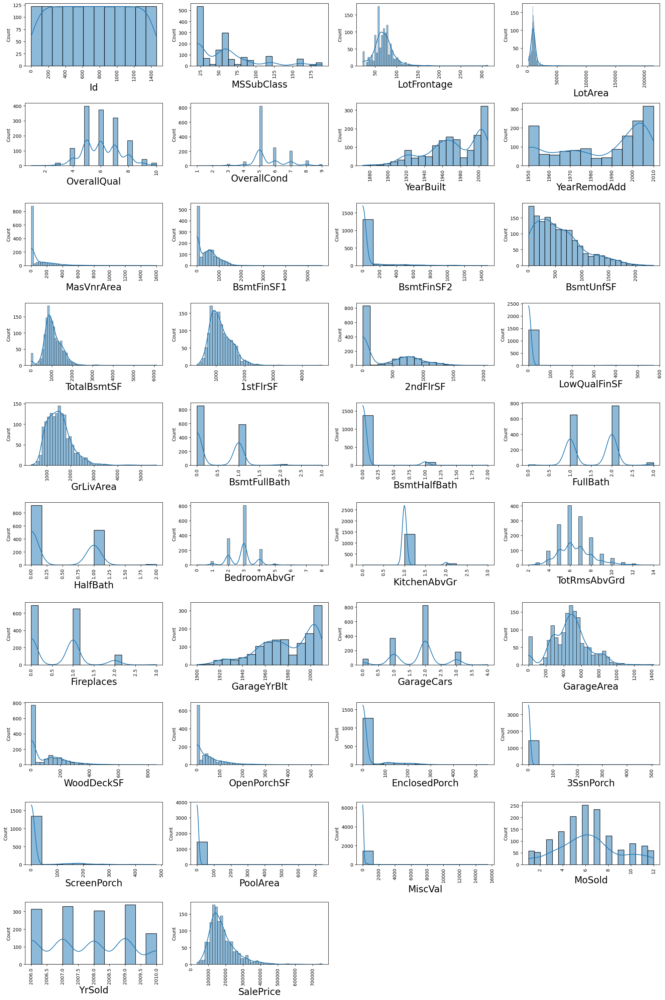

In [23]:
# univariate analysis
plt.figure(figsize=(20,30)) # define the plot size
plt_num=1
for column in numerical_col:
    if plt_num<=38: # assign the column value
        plt.subplot(10,4,plt_num) # row and column assign
        sns.histplot(df[column],kde=True) # create the histogram plot
        plt.xlabel(column,fontsize=20)
        plt.xticks(rotation=90) # assign the xlabel value
    plt_num+=1
plt.tight_layout() # use for data show function

**Insights:-**
* Here we can see the normal distibution in 1stFlrSF and GrLivArea and TotalBsmtSF.
* Here we are normal distribution time use mean, median or mode equall but not normal distribution time only use median.

# Bivariant Analysis

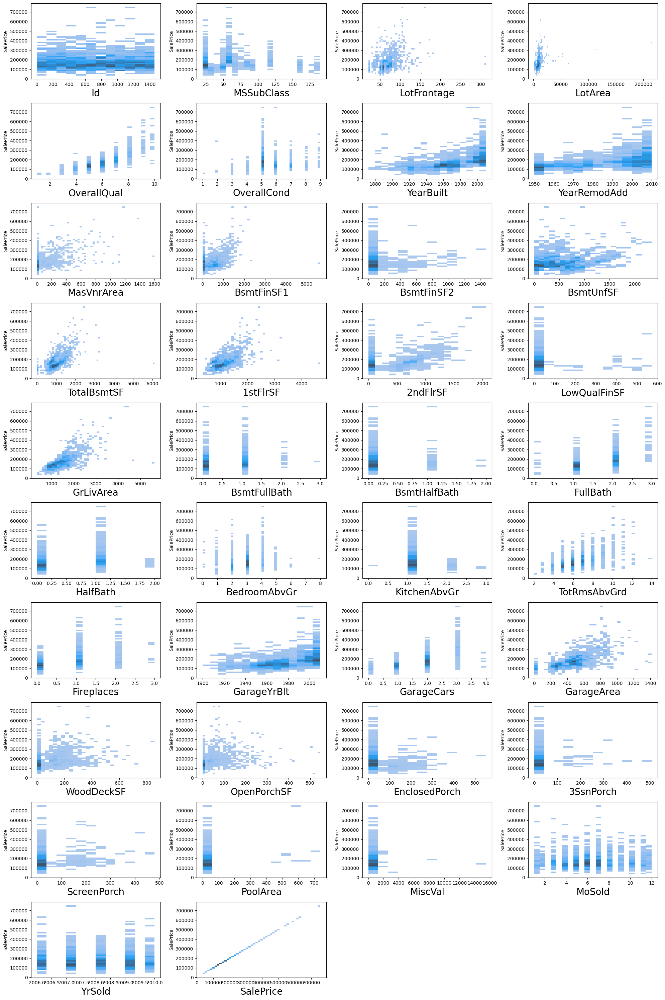

In [24]:
# Biavariant analysis of numerical columns
plt.figure(figsize=(20,30))
plt_num=1
for column in numerical_col:
    if plt_num<=38:
        plt.subplot(10,4,plt_num)
        sns.histplot(x=df[column],y=df.SalePrice,kde=True)
        plt.xlabel(column,fontsize=20)
    plt_num+=1
plt.tight_layout()

**Insights:-**
* Here we can see the possitvie corelation between 1stFlrSF and SalesPrice.
* Here we can see the possitvie corelation between GrLivArea and SalesPrice.

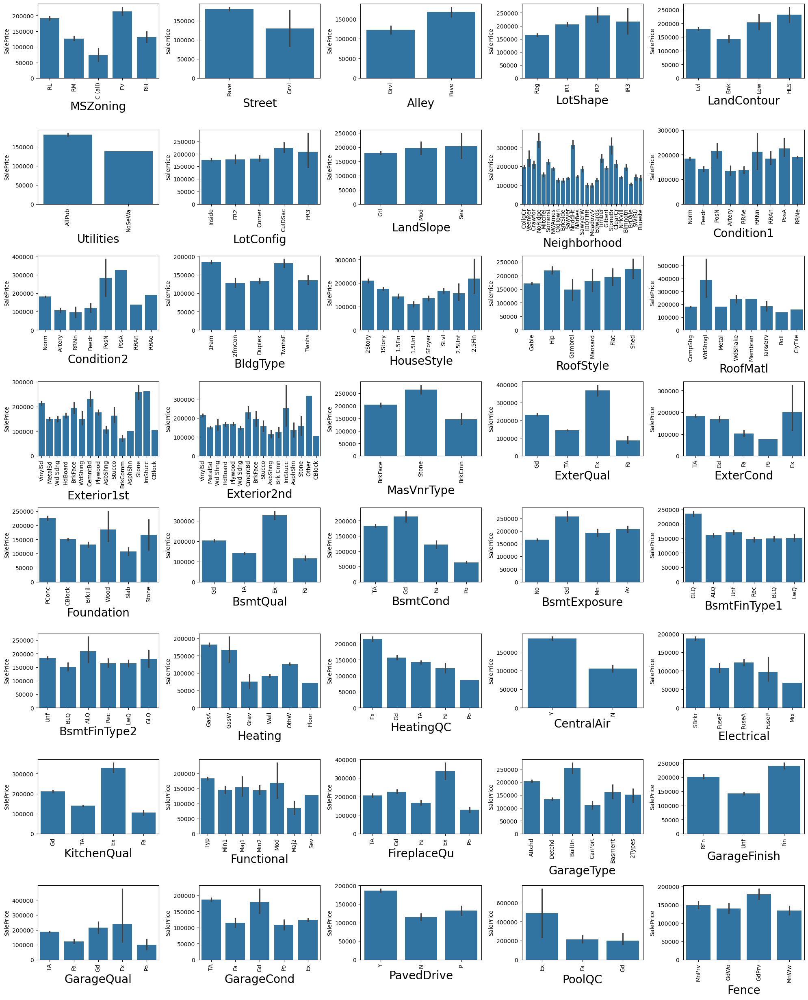

In [25]:
# Biavariant analysis of categorical columns
plt.figure(figsize=(20,30))
plt_num=1
for column in categorical_col:
    if plt_num<=40:
        plt.subplot(10,5,plt_num)
        sns.barplot(x=df[column],y=df.SalePrice)
        plt.xlabel(column,fontsize=20)
        plt.xticks(rotation=90)
    plt_num+=1
plt.tight_layout()

**Insights:-**
* Highest MSZoning: FV
* Highest Street: Paved
* Highest Alley: Paved
* Highest LotShape: IR2
* Highest LandContour: HLS
* Highest Utilities: AllPub
* Highest LotConfig: CulDeSac
* Highest LandSlope: Severe
* Highest BldgType: 1Fam
* Highest RoofStyle: Shed
* Highest MasVnrType: Stone
* Highest ExterQual/Cond: Excellent (Ex)
* Highest Foundation: PConc
* Highest BsmtQual/Cond/Exposure: Excellent (Ex)/Good (Gd)
* Highest BsmtFinType1: GLQ
* Highest Heating: GasA
* Highest HeatingQC: Excellent (Ex)
* Highest CentralAir: Yes (Y)
* Highest Electrical: SBrkr
* Highest Functional: Typical (Typ)
* Highest GarageType: Built-In
* Highest GarageFinish: Finished (Fin)
* Highest Fence: GdPrv

# Multivariant Analysis

In [23]:
sns.pairplot(df,hue="SalePrice") # used for check dataset columns relationship

## Final EDA Report
* The dataset reveals several key patterns related to house prices. There is a positive correlation between 1st Floor Square Feet (1stFlrSF) and Ground Living Area (GrLivArea) with SalesPrice, indicating that larger living spaces lead to higher prices.
* In terms of zoning, houses in the FV (Floating Village) zone tend to have the highest prices, while nearly all homes are located on Paved streets. Additionally, Paved alleys, IR2 lot shapes, and HLS land contours are associated with higher sales prices.
*  Homes with high-quality external features, such as Stone veneer, Excellent exterior condition (ExterQual), and Poured Concrete (PConc) foundations, command premium prices. Features like Central Air (Y), GLQ basement finishing, and Built-in garages also contribute to increased property value.








# Feature Engineering

**Feature Engineering:-** Feature engineering is the process of creating new input features or modifying existing ones to improve model performance. It involves techniques like combining variables, extracting useful information, or transforming data to highlight important patterns. Good feature engineering can enhance a model's predictive power.

**There are two stage of feature engineering**
1. Data Preprocessing
2. Feature Selection

# 1. Data Preprocessing

* Data preprocessing is the process of cleaning and transforming raw data into a usable format for analysis. It involves handling missing values, encoding categorical variables, scaling features, and removing noise to ensure the data is ready for model building. Effective preprocessing improves model accuracy and performance.

In [26]:
pd.set_option("display.max_rows",None) # Display all columns

In [27]:
df.isnull().sum() # Checking null values

Id                  0
MSSubClass          0
MSZoning            0
LotFrontage       259
LotArea             0
Street              0
Alley            1369
LotShape            0
LandContour         0
Utilities           0
LotConfig           0
LandSlope           0
Neighborhood        0
Condition1          0
Condition2          0
BldgType            0
HouseStyle          0
OverallQual         0
OverallCond         0
YearBuilt           0
YearRemodAdd        0
RoofStyle           0
RoofMatl            0
Exterior1st         0
Exterior2nd         0
MasVnrType        872
MasVnrArea          8
ExterQual           0
ExterCond           0
Foundation          0
BsmtQual           37
BsmtCond           37
BsmtExposure       38
BsmtFinType1       37
BsmtFinSF1          0
BsmtFinType2       38
BsmtFinSF2          0
BsmtUnfSF           0
TotalBsmtSF         0
Heating             0
HeatingQC           0
CentralAir          0
Electrical          1
1stFlrSF            0
2ndFlrSF            0
LowQualFin

In [28]:
# Get the percentage of null value
null_percent=df.isnull().sum()/df.shape[0]*100
null_percent

Id                0.000000
MSSubClass        0.000000
MSZoning          0.000000
LotFrontage      17.739726
LotArea           0.000000
Street            0.000000
Alley            93.767123
LotShape          0.000000
LandContour       0.000000
Utilities         0.000000
LotConfig         0.000000
LandSlope         0.000000
Neighborhood      0.000000
Condition1        0.000000
Condition2        0.000000
BldgType          0.000000
HouseStyle        0.000000
OverallQual       0.000000
OverallCond       0.000000
YearBuilt         0.000000
YearRemodAdd      0.000000
RoofStyle         0.000000
RoofMatl          0.000000
Exterior1st       0.000000
Exterior2nd       0.000000
MasVnrType       59.726027
MasVnrArea        0.547945
ExterQual         0.000000
ExterCond         0.000000
Foundation        0.000000
BsmtQual          2.534247
BsmtCond          2.534247
BsmtExposure      2.602740
BsmtFinType1      2.534247
BsmtFinSF1        0.000000
BsmtFinType2      2.602740
BsmtFinSF2        0.000000
B

* Here we remove columns that consist more that 40% null values of data

In [29]:
for column in df: # here we remove columns that consis more than 40% null value
    if (df[column].isnull().sum()/df.shape[0]*100>=40.0):
        df.drop(columns=[column],inplace=True)

In [30]:
df.isnull().sum()/df.shape[0]*100 # checking null value percentage

Id                0.000000
MSSubClass        0.000000
MSZoning          0.000000
LotFrontage      17.739726
LotArea           0.000000
Street            0.000000
LotShape          0.000000
LandContour       0.000000
Utilities         0.000000
LotConfig         0.000000
LandSlope         0.000000
Neighborhood      0.000000
Condition1        0.000000
Condition2        0.000000
BldgType          0.000000
HouseStyle        0.000000
OverallQual       0.000000
OverallCond       0.000000
YearBuilt         0.000000
YearRemodAdd      0.000000
RoofStyle         0.000000
RoofMatl          0.000000
Exterior1st       0.000000
Exterior2nd       0.000000
MasVnrArea        0.547945
ExterQual         0.000000
ExterCond         0.000000
Foundation        0.000000
BsmtQual          2.534247
BsmtCond          2.534247
BsmtExposure      2.602740
BsmtFinType1      2.534247
BsmtFinSF1        0.000000
BsmtFinType2      2.602740
BsmtFinSF2        0.000000
BsmtUnfSF         0.000000
TotalBsmtSF       0.000000
H

In [31]:
# find the unique values number and unique value of each column

for i in df:
    print('Values:-{} ({}) \n {} \n'.format(i,len(df[i].unique()),df[i].unique()))

Values:-Id (1460) 
 [   1    2    3 ... 1458 1459 1460] 

Values:-MSSubClass (15) 
 [ 60  20  70  50 190  45  90 120  30  85  80 160  75 180  40] 

Values:-MSZoning (5) 
 ['RL' 'RM' 'C (all)' 'FV' 'RH'] 

Values:-LotFrontage (111) 
 [ 65.  80.  68.  60.  84.  85.  75.  nan  51.  50.  70.  91.  72.  66.
 101.  57.  44. 110.  98.  47. 108. 112.  74. 115.  61.  48.  33.  52.
 100.  24.  89.  63.  76.  81.  95.  69.  21.  32.  78. 121. 122.  40.
 105.  73.  77.  64.  94.  34.  90.  55.  88.  82.  71. 120. 107.  92.
 134.  62.  86. 141.  97.  54.  41.  79. 174.  99.  67.  83.  43. 103.
  93.  30. 129. 140.  35.  37. 118.  87. 116. 150. 111.  49.  96.  59.
  36.  56. 102.  58.  38. 109. 130.  53. 137.  45. 106. 104.  42.  39.
 144. 114. 128. 149. 313. 168. 182. 138. 160. 152. 124. 153.  46.] 

Values:-LotArea (1073) 
 [ 8450  9600 11250 ... 17217 13175  9717] 

Values:-Street (2) 
 ['Pave' 'Grvl'] 

Values:-LotShape (4) 
 ['Reg' 'IR1' 'IR2' 'IR3'] 

Values:-LandContour (4) 
 ['Lvl' 'Bnk' 'Lo

In [32]:
for i in df: # Getting column name which has null values and cosist unique values less than 10
    if(df[i].isnull().sum()!=0):
        uni_val=df[i].nunique()
        if(uni_val<10):
            print(i)

BsmtQual
BsmtCond
BsmtExposure
BsmtFinType1
BsmtFinType2
Electrical
GarageType
GarageFinish
GarageQual
GarageCond


In [33]:
for i in df:  # Filling null values
    if(df[i].isnull().sum()!=0):
        uni_val=df[i].nunique()
        if(uni_val<10):
            mod=df[i].mode()[0]
            df.loc[df[i].isnull(),i] = mod
        elif(uni_val>10):
            df.loc[df[i].isnull(),i] = df[i].median()

In [34]:
df.isnull().sum() # checking null values

Id               0
MSSubClass       0
MSZoning         0
LotFrontage      0
LotArea          0
Street           0
LotShape         0
LandContour      0
Utilities        0
LotConfig        0
LandSlope        0
Neighborhood     0
Condition1       0
Condition2       0
BldgType         0
HouseStyle       0
OverallQual      0
OverallCond      0
YearBuilt        0
YearRemodAdd     0
RoofStyle        0
RoofMatl         0
Exterior1st      0
Exterior2nd      0
MasVnrArea       0
ExterQual        0
ExterCond        0
Foundation       0
BsmtQual         0
BsmtCond         0
BsmtExposure     0
BsmtFinType1     0
BsmtFinSF1       0
BsmtFinType2     0
BsmtFinSF2       0
BsmtUnfSF        0
TotalBsmtSF      0
Heating          0
HeatingQC        0
CentralAir       0
Electrical       0
1stFlrSF         0
2ndFlrSF         0
LowQualFinSF     0
GrLivArea        0
BsmtFullBath     0
BsmtHalfBath     0
FullBath         0
HalfBath         0
BedroomAbvGr     0
KitchenAbvGr     0
KitchenQual      0
TotRmsAbvGrd

# Outliers removing

**Outliers:-** Outliers are data points that differ significantly from the majority of the data, often due to variability, errors, or unusual conditions. They can distort statistical analyses and model predictions if not properly handled.

In [35]:
continue_col=['LotFrontage','LotArea','MasVnrArea','BsmtFinSF1','BsmtFinSF2',
         'BsmtUnfSF','TotalBsmtSF','1stFlrSF','2ndFlrSF','LowQualFinSF',
         'GrLivArea','GarageArea','WoodDeckSF','OpenPorchSF','EnclosedPorch',
         '3SsnPorch','ScreenPorch','PoolArea','MiscVal']  # Creating new variable for continuos columns

In [36]:
len(continue_col)

19

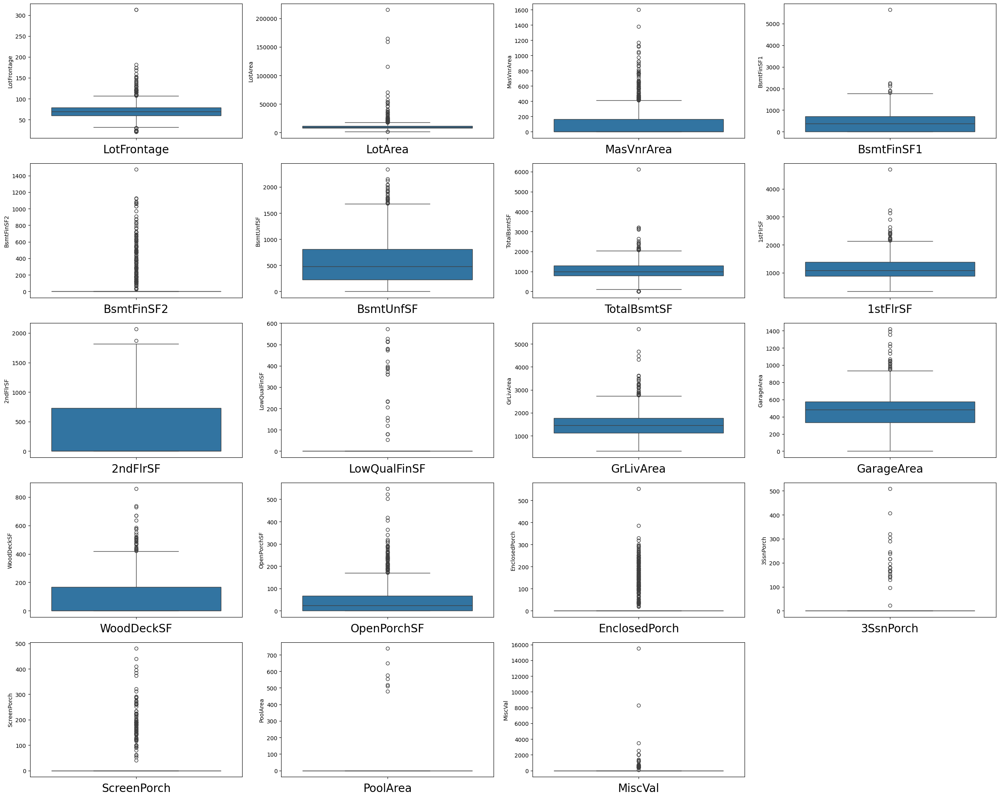

In [37]:
plt.figure(figsize=(25,20)) # checking outliers
plt_num=1
for column in continue_col:
    if plt_num<=81:
        plt.subplot(5,4,plt_num)
        sns.boxplot(df[column]) # Create boxplot
        plt.xlabel(column,fontsize=20)
    plt_num+=1
plt.tight_layout()

Here we can see that there are many continues columns that have outliers but here we don't remove all column's outliers beacause of Some outliers may represent valid, rare, but important instances, such as luxury homes with large values for features like GrLivArea or LotArea. Removing these could result in loss of valuable information.

Columns in which we remove outliers:- \
 --> LotFrontage\
 --> MasVnrArea\
 --> BsmtFinSF1\
 --> BsmtFinSF2\
 --> TotalBsmtSF\
 --> 1stFlrSF\
 --> 2ndFlrSF\
 --> GarageArea\
 --> WoodDeckSF\
 --> OpenPorchSF\
 --> EnclosedPorch\
 --> ScreenPorch\
 --> 3SsnPorch\
 --> PoolArea\
 --> MiscVal


<Axes: ylabel='LotFrontage'>

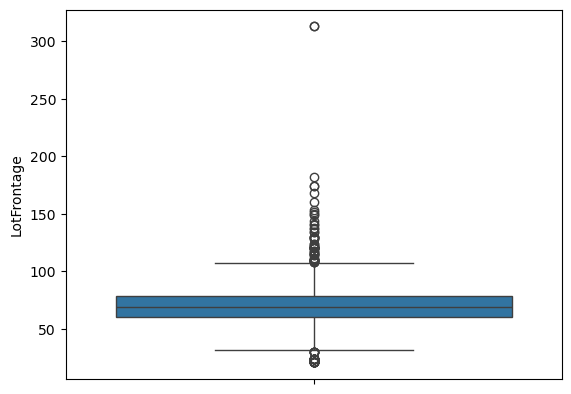

In [38]:
sns.boxplot(df.LotFrontage)

In [39]:
df.loc[df['LotFrontage']>155,'LotFrontage'] # find the outliers

197     174.0
231     174.0
934     313.0
1107    168.0
1127    182.0
1182    160.0
1298    313.0
Name: LotFrontage, dtype: float64

In [40]:
df.loc[df['LotFrontage']>155,'LotFrontage'] = df.LotFrontage.median()  # remove outliers with median

<Axes: ylabel='LotFrontage'>

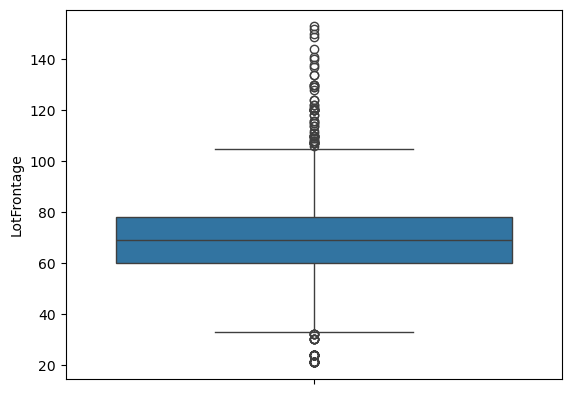

In [41]:
sns.boxplot(df.LotFrontage)

<Axes: ylabel='MasVnrArea'>

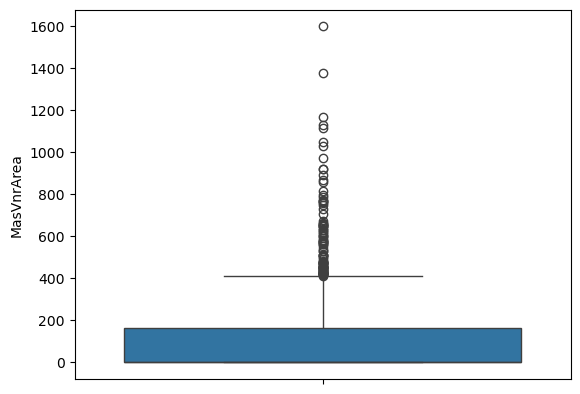

In [42]:
sns.boxplot(df.MasVnrArea) #checking outliers

In [43]:
df.loc[df["MasVnrArea"]>850,'MasVnrArea']

58      1031.0
70      1115.0
115     1129.0
224      922.0
297     1600.0
349      870.0
517      921.0
691     1170.0
755      894.0
798      860.0
808     1047.0
981      975.0
1169    1378.0
Name: MasVnrArea, dtype: float64

In [44]:
df.loc[df["MasVnrArea"]>850,'MasVnrArea']=df.MasVnrArea.median() # Remove outliers with median

<Axes: ylabel='MasVnrArea'>

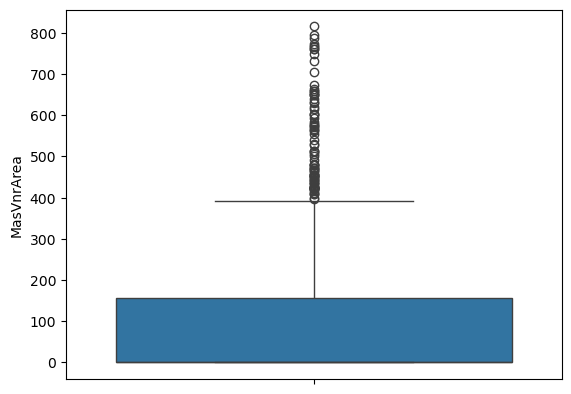

In [45]:
sns.boxplot(df.MasVnrArea)

<Axes: ylabel='BsmtFinSF1'>

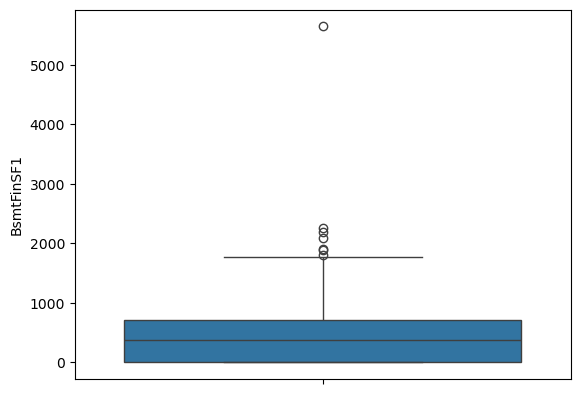

In [46]:
sns.boxplot(df.BsmtFinSF1) #checking outliers

In [47]:
df.loc[df['BsmtFinSF1']>2000,'BsmtFinSF1']  # find the outliers

523     2260
898     2188
1182    2096
1298    5644
Name: BsmtFinSF1, dtype: int64

In [48]:
df.loc[df['BsmtFinSF1']>2000,'BsmtFinSF1'] = df.BsmtFinSF1.median() # remove outliers with median

<Axes: ylabel='BsmtFinSF1'>

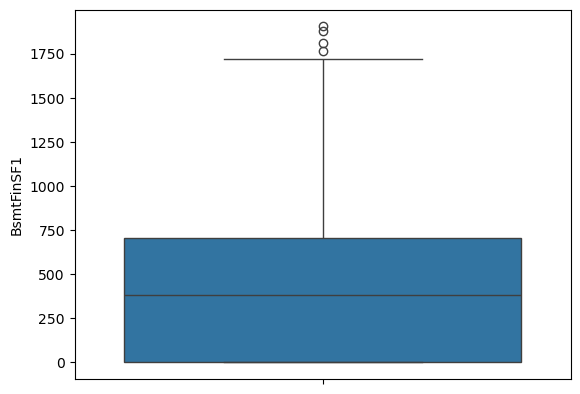

In [49]:
sns.boxplot(df.BsmtFinSF1) #checking outliers

<Axes: ylabel='BsmtFinSF2'>

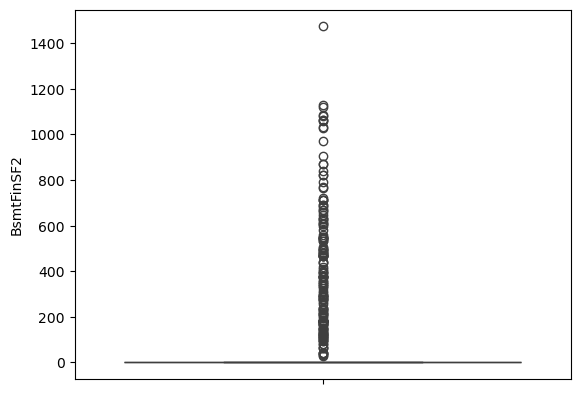

In [50]:
sns.boxplot(df.BsmtFinSF2)#checking outliers

In [51]:
df.loc[df['BsmtFinSF2']>1200,'BsmtFinSF2'] = df.BsmtFinSF2.median() # remove outliers with median

<Axes: ylabel='BsmtFinSF2'>

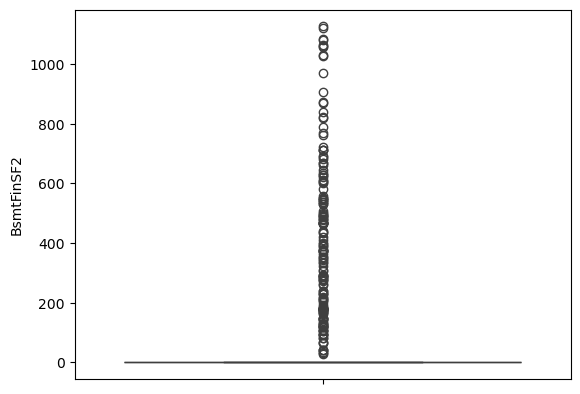

In [52]:
sns.boxplot(df.BsmtFinSF2) #checking outliers

In [53]:
df.loc[df['BsmtFinSF2']>850,'BsmtFinSF2'] = df.BsmtFinSF2.median() # remove outliers with median

<Axes: ylabel='BsmtFinSF2'>

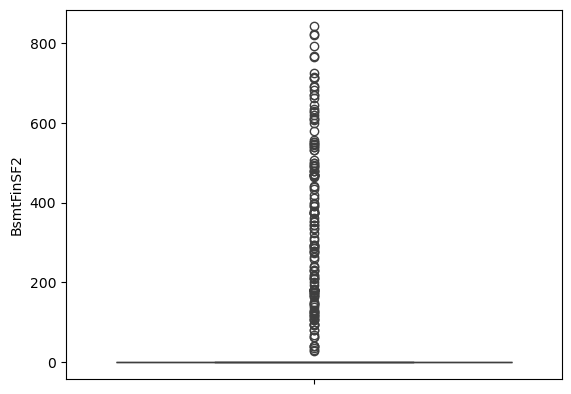

In [54]:
sns.boxplot(df.BsmtFinSF2) #checking outliers

<Axes: ylabel='TotalBsmtSF'>

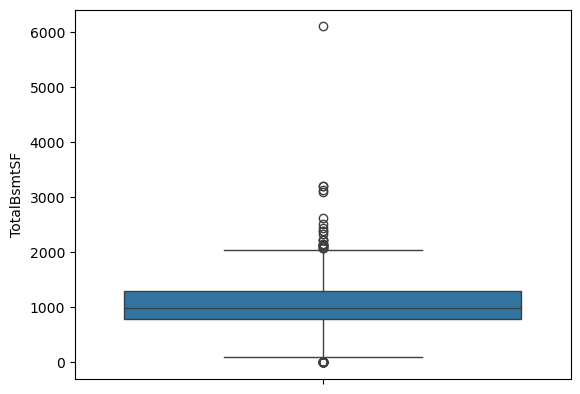

In [55]:
sns.boxplot(df.TotalBsmtSF) #checking outliers

In [56]:
df.loc[df['TotalBsmtSF']>3000,'TotalBsmtSF'] # find the outliers

332     3206
440     3094
496     3200
523     3138
1298    6110
Name: TotalBsmtSF, dtype: int64

In [57]:
df.loc[df['TotalBsmtSF']>3000,'TotalBsmtSF'] = df.TotalBsmtSF.median()

<Axes: ylabel='TotalBsmtSF'>

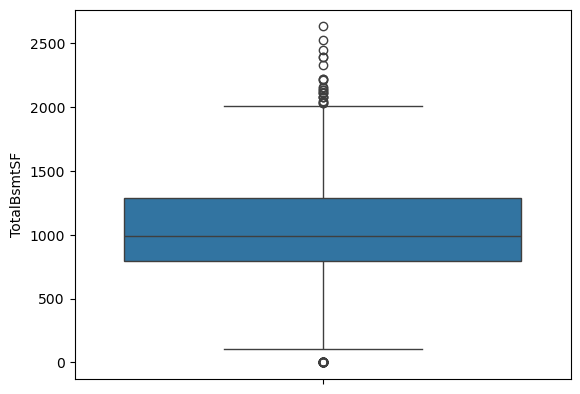

In [58]:
sns.boxplot(df.TotalBsmtSF) #checking outliers

<Axes: ylabel='1stFlrSF'>

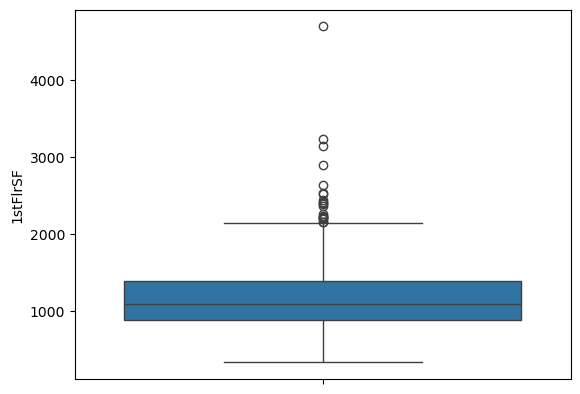

In [59]:
sns.boxplot(df['1stFlrSF']) #checking outliers

In [60]:
df.loc[df['1stFlrSF']>2800,'1stFlrSF'] # find the outliers

496     3228
523     3138
1024    2898
1298    4692
Name: 1stFlrSF, dtype: int64

In [61]:
df.loc[df['1stFlrSF']>2800,'1stFlrSF'] = df['1stFlrSF'].median() # remove outliers with median

<Axes: ylabel='1stFlrSF'>

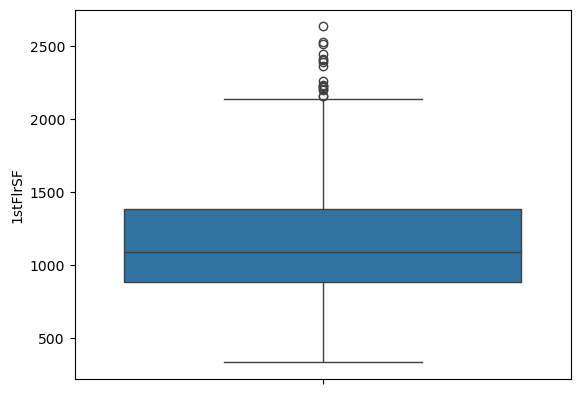

In [62]:
sns.boxplot(df['1stFlrSF']) #checking outliers

<Axes: ylabel='2ndFlrSF'>

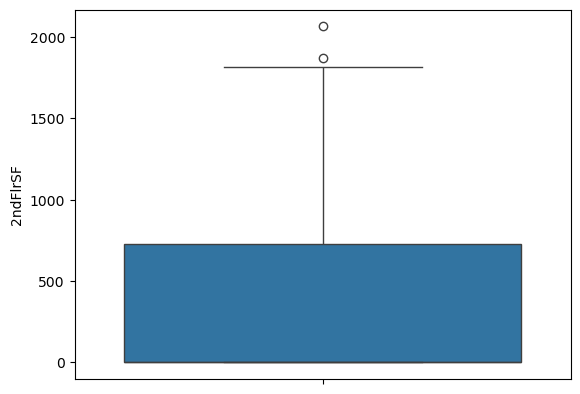

In [63]:
sns.boxplot(df['2ndFlrSF']) #checking outliers

In [64]:
df.loc[df['2ndFlrSF']>1850,'2ndFlrSF'] # find the outliers

691     1872
1182    2065
Name: 2ndFlrSF, dtype: int64

In [65]:
df.loc[df['2ndFlrSF']>1850,'2ndFlrSF'] =df['2ndFlrSF'].median() # remove outliers with median

<Axes: ylabel='2ndFlrSF'>

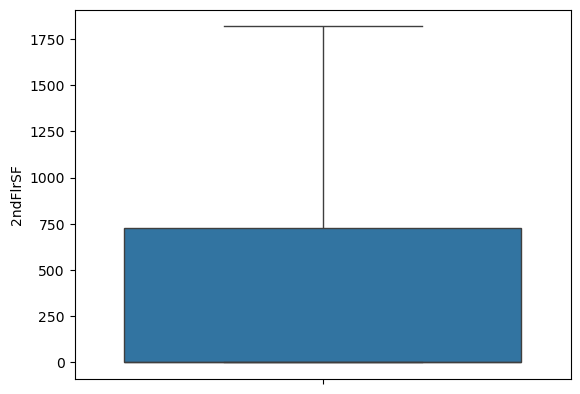

In [66]:
sns.boxplot(df['2ndFlrSF']) #checking outliers

<Axes: ylabel='GarageArea'>

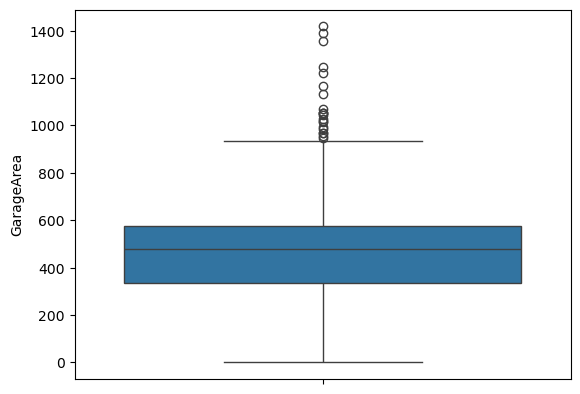

In [67]:
sns.boxplot(df.GarageArea) #checking outliers

In [68]:
df.loc[df['GarageArea']>1100,'GarageArea'] # find the outliers

178     1166
581     1390
664     1134
825     1220
1061    1248
1190    1356
1298    1418
Name: GarageArea, dtype: int64

In [69]:
df.loc[df['GarageArea']>1100,'GarageArea'] = df.GarageArea.median() # remove outliers with median

<Axes: ylabel='GarageArea'>

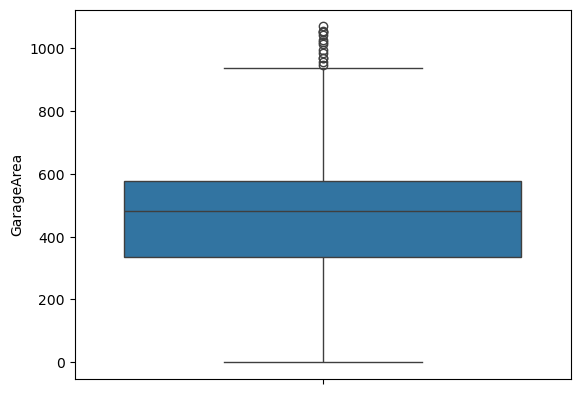

In [70]:
sns.boxplot(df.GarageArea) #checking outliers

<Axes: ylabel='WoodDeckSF'>

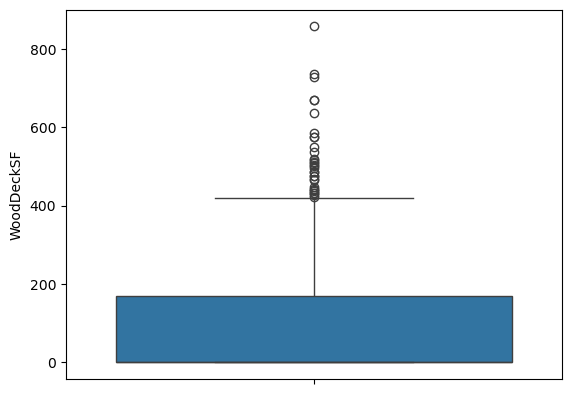

In [71]:
sns.boxplot(df.WoodDeckSF) #checking outliers

In [72]:
df.loc[df.WoodDeckSF>600,'WoodDeckSF'] # find the outliers

53      857
335     670
1068    728
1210    635
1313    668
1459    736
Name: WoodDeckSF, dtype: int64

In [73]:
df.loc[df.WoodDeckSF>600,'WoodDeckSF'] = df.WoodDeckSF.median() # remove outliers with median

<Axes: ylabel='WoodDeckSF'>

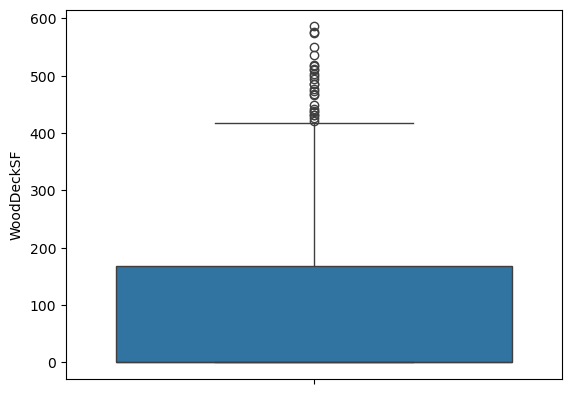

In [74]:
sns.boxplot(df.WoodDeckSF) #checking outliers

<Axes: ylabel='OpenPorchSF'>

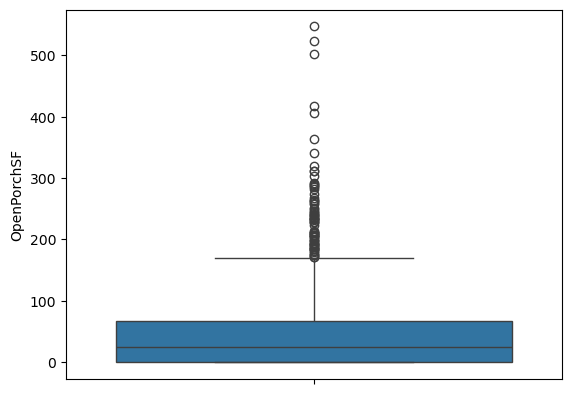

In [75]:
sns.boxplot(df.OpenPorchSF) #checking outliers

In [76]:
df.loc[df.OpenPorchSF>330,'OpenPorchSF'] # find the outliers

495     523
523     406
583     502
735     341
854     418
875     364
1328    547
Name: OpenPorchSF, dtype: int64

In [77]:
df.loc[df.OpenPorchSF>330,'OpenPorchSF'] = df.OpenPorchSF.median() # remove outliers with median

<Axes: ylabel='OpenPorchSF'>

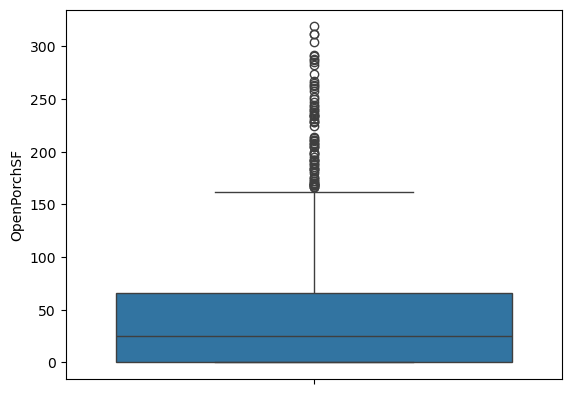

In [78]:
sns.boxplot(df.OpenPorchSF) #checking outliers

<Axes: ylabel='EnclosedPorch'>

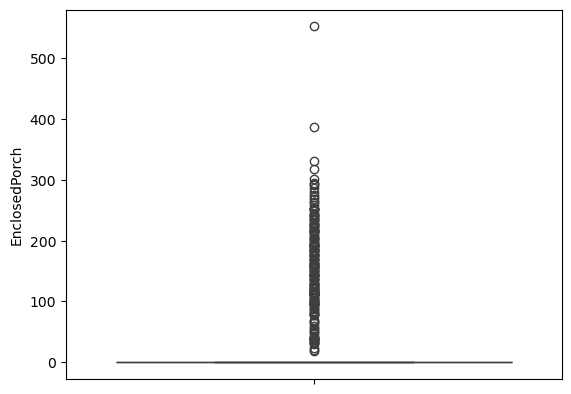

In [79]:
sns.boxplot(df.EnclosedPorch) #checking outliers

In [80]:
df.loc[df.EnclosedPorch>350,'EnclosedPorch'] # find the outliers

197    552
747    386
Name: EnclosedPorch, dtype: int64

In [81]:
df.loc[df.EnclosedPorch>350,'EnclosedPorch'] =df.EnclosedPorch.median() # remove outliers with median

<Axes: ylabel='EnclosedPorch'>

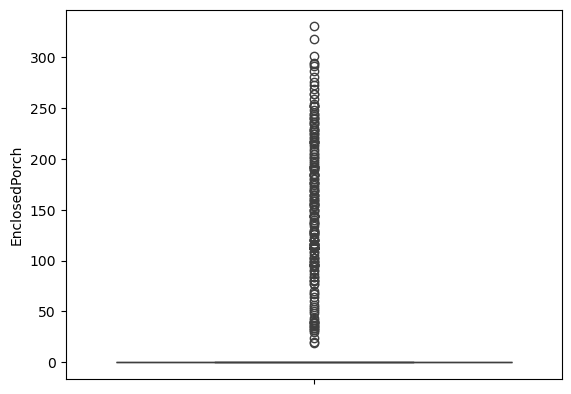

In [82]:
sns.boxplot(df.EnclosedPorch) #checking outliers

<Axes: ylabel='ScreenPorch'>

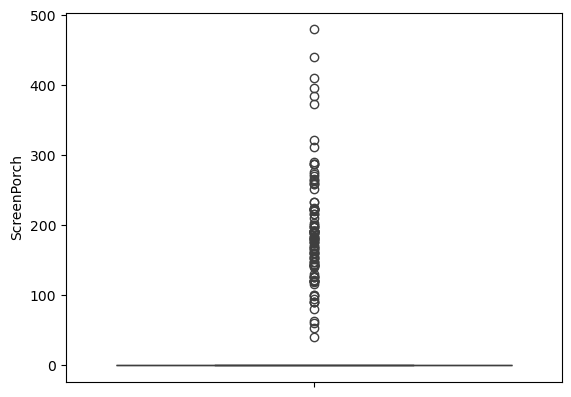

In [83]:
sns.boxplot(df.ScreenPorch) #checking outliers

In [84]:
df.loc[df.ScreenPorch> 350,'ScreenPorch'] # find the outliers

185     410
359     374
426     396
625     385
1328    480
1386    440
Name: ScreenPorch, dtype: int64

In [85]:
df.loc[df.ScreenPorch> 350,'ScreenPorch'] = df.ScreenPorch.median() # remove outliers with median

<Axes: ylabel='ScreenPorch'>

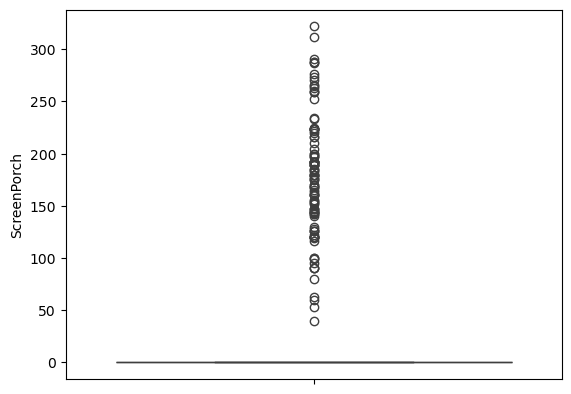

In [86]:
sns.boxplot(df.ScreenPorch) #checking outliers

<Axes: ylabel='3SsnPorch'>

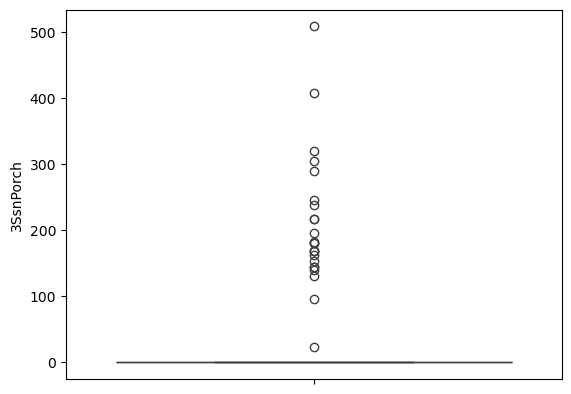

In [87]:
sns.boxplot(df['3SsnPorch']) #checking outliers

In [88]:
df.loc[df['3SsnPorch']>400,'3SsnPorch'] # find the outliers

55     407
205    508
Name: 3SsnPorch, dtype: int64

In [89]:
df.loc[df['3SsnPorch']>400,'3SsnPorch'] = df['3SsnPorch'].median() # remove outliers with median

<Axes: ylabel='3SsnPorch'>

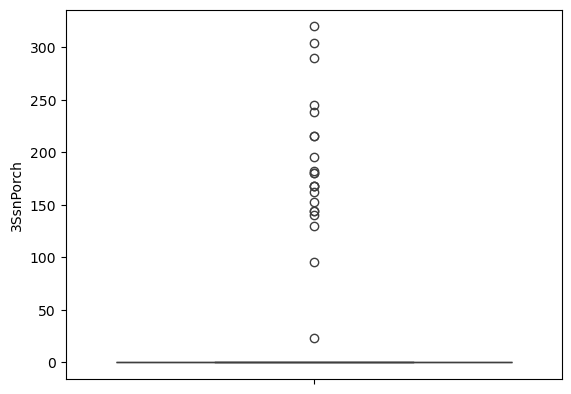

In [90]:
sns.boxplot(df['3SsnPorch']) #checking outliers

<Axes: ylabel='PoolArea'>

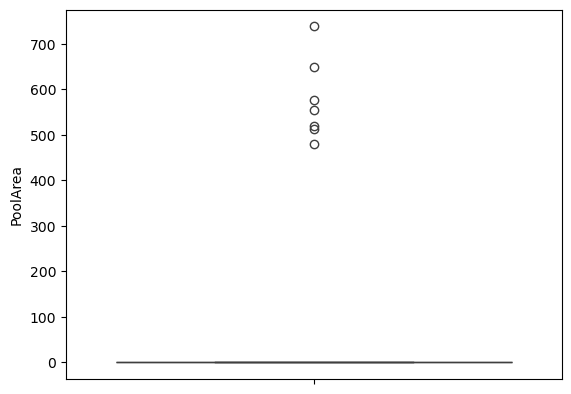

In [91]:
sns.boxplot(df.PoolArea) #checking outliers

In [92]:
df.loc[df.PoolArea>600,'PoolArea'] # find the outliers

810     648
1423    738
Name: PoolArea, dtype: int64

In [93]:
df.loc[df.PoolArea>600,'PoolArea'] = df.PoolArea.median() # remove outliers with median

<Axes: ylabel='MiscVal'>

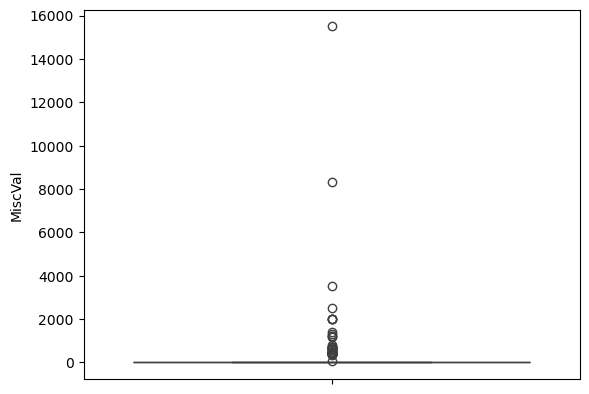

In [94]:
sns.boxplot(df.MiscVal) #checking outliers

In [95]:
df.loc[df.MiscVal>2000,'MiscVal']  # find the outliers

346     15500
705      3500
1230     8300
1457     2500
Name: MiscVal, dtype: int64

In [96]:
df.loc[df.MiscVal>2000,'MiscVal'] = df.MiscVal.median() # remove outliers with median

<Axes: ylabel='MiscVal'>

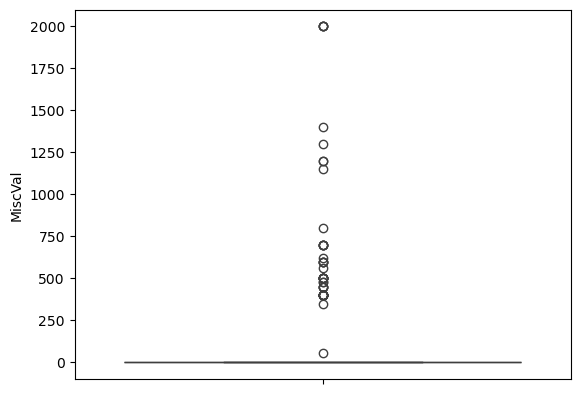

In [97]:
sns.boxplot(df.MiscVal) #checking outliers

# Now convert Categorical data into Numerical

So basically we have some columns which has data into categorical. So, we have to change that into numerical. Because our machine don't understand categorical data.

- To convert categorical data into numerical we have some technique which are,
1. Label Encoder
2. Ordinal Encoder
3. One Hot Encoder

In [98]:
object=[] # Creating list for categorical columns
for i in df:
    if (df[i].dtype == "object"):
        object.append(i)

In [99]:
object

['MSZoning',
 'Street',
 'LotShape',
 'LandContour',
 'Utilities',
 'LotConfig',
 'LandSlope',
 'Neighborhood',
 'Condition1',
 'Condition2',
 'BldgType',
 'HouseStyle',
 'RoofStyle',
 'RoofMatl',
 'Exterior1st',
 'Exterior2nd',
 'ExterQual',
 'ExterCond',
 'Foundation',
 'BsmtQual',
 'BsmtCond',
 'BsmtExposure',
 'BsmtFinType1',
 'BsmtFinType2',
 'Heating',
 'HeatingQC',
 'CentralAir',
 'Electrical',
 'KitchenQual',
 'Functional',
 'GarageType',
 'GarageFinish',
 'GarageQual',
 'GarageCond',
 'PavedDrive',
 'SaleType',
 'SaleCondition']

In [100]:
for i in object: # Showing unique value number and unique values
    print('Values:-{} ({}) \n {} \n'.format(i,len(df[i].unique()),df[i].unique()))

Values:-MSZoning (5) 
 ['RL' 'RM' 'C (all)' 'FV' 'RH'] 

Values:-Street (2) 
 ['Pave' 'Grvl'] 

Values:-LotShape (4) 
 ['Reg' 'IR1' 'IR2' 'IR3'] 

Values:-LandContour (4) 
 ['Lvl' 'Bnk' 'Low' 'HLS'] 

Values:-Utilities (2) 
 ['AllPub' 'NoSeWa'] 

Values:-LotConfig (5) 
 ['Inside' 'FR2' 'Corner' 'CulDSac' 'FR3'] 

Values:-LandSlope (3) 
 ['Gtl' 'Mod' 'Sev'] 

Values:-Neighborhood (25) 
 ['CollgCr' 'Veenker' 'Crawfor' 'NoRidge' 'Mitchel' 'Somerst' 'NWAmes'
 'OldTown' 'BrkSide' 'Sawyer' 'NridgHt' 'NAmes' 'SawyerW' 'IDOTRR'
 'MeadowV' 'Edwards' 'Timber' 'Gilbert' 'StoneBr' 'ClearCr' 'NPkVill'
 'Blmngtn' 'BrDale' 'SWISU' 'Blueste'] 

Values:-Condition1 (9) 
 ['Norm' 'Feedr' 'PosN' 'Artery' 'RRAe' 'RRNn' 'RRAn' 'PosA' 'RRNe'] 

Values:-Condition2 (8) 
 ['Norm' 'Artery' 'RRNn' 'Feedr' 'PosN' 'PosA' 'RRAn' 'RRAe'] 

Values:-BldgType (5) 
 ['1Fam' '2fmCon' 'Duplex' 'TwnhsE' 'Twnhs'] 

Values:-HouseStyle (8) 
 ['2Story' '1Story' '1.5Fin' '1.5Unf' 'SFoyer' 'SLvl' '2.5Unf' '2.5Fin'] 

Values:-Roof

In [101]:
# Drop column which have more than 15 unique values
df.drop('Neighborhood',axis=1,inplace=True)
df.drop('Exterior1st',axis=1,inplace=True)
df.drop('Exterior2nd',axis=1,inplace=True)

### Label Encoder

In [102]:
# Create list for some features in which we use label encoder
label=['MSZoning','Street','LotShape','LandContour','Utilities','LotConfig','LandSlope','Condition1','Condition2','BldgType',
        'HouseStyle','RoofStyle','RoofMatl','Foundation','BsmtFinType1','BsmtFinType2','Heating','Electrical','GarageType','GarageFinish',
        'SaleType','SaleCondition','CentralAir','PavedDrive']

#### Reason for using label Encoder:-
* Label Encoding was chosen for the following features because they represent categorical variables with ordinal or non-ordinal values that are either binary or have a manageable number of unique categories. Using Label Encoding converts these categories into numerical representations efficiently, which allows machine learning algorithms that expect numeric input to process them correctly. Since these features don't  require complex encoding (like one-hot encoding), and their unique values are limited, Label Encoding was an appropriate choice.

In [103]:
from sklearn.preprocessing import LabelEncoder
lb=LabelEncoder()

In [104]:
for i in label:
    df[i]=lb.fit_transform(df[i]) # Here we are tranforming categorical data into numerical using label encoder

In [105]:
df.head()

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,LotShape,LandContour,Utilities,LotConfig,LandSlope,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,1,60,3,65.0,8450,1,3,3,0,4,0,2,2,0,5,7,5,2003,2003,1,1,196.0,Gd,TA,2,Gd,TA,No,2,706.0,5,0,150,856.0,1,Ex,1,4,856,854,0,1710,1,0,2,1,3,1,Gd,8,Typ,0,1,2003.0,1,2,548,TA,TA,2,0,61,0,0,0,0,0,2,2008,8,4,208500
1,2,20,3,80.0,9600,1,3,3,0,2,0,1,2,0,2,6,8,1976,1976,1,1,0.0,TA,TA,1,Gd,TA,Gd,0,978.0,5,0,284,1262.0,1,Ex,1,4,1262,0,0,1262,0,1,2,0,3,1,TA,6,Typ,1,1,1976.0,1,2,460,TA,TA,2,298,0,0,0,0,0,0,5,2007,8,4,181500
2,3,60,3,68.0,11250,1,0,3,0,4,0,2,2,0,5,7,5,2001,2002,1,1,162.0,Gd,TA,2,Gd,TA,Mn,2,486.0,5,0,434,920.0,1,Ex,1,4,920,866,0,1786,1,0,2,1,3,1,Gd,6,Typ,1,1,2001.0,1,2,608,TA,TA,2,0,42,0,0,0,0,0,9,2008,8,4,223500
3,4,70,3,60.0,9550,1,0,3,0,0,0,2,2,0,5,7,5,1915,1970,1,1,0.0,TA,TA,0,TA,Gd,No,0,216.0,5,0,540,756.0,1,Gd,1,4,961,756,0,1717,1,0,1,0,3,1,Gd,7,Typ,1,5,1998.0,2,3,642,TA,TA,2,0,35,272,0,0,0,0,2,2006,8,0,140000
4,5,60,3,84.0,14260,1,0,3,0,2,0,2,2,0,5,8,5,2000,2000,1,1,350.0,Gd,TA,2,Gd,TA,Av,2,655.0,5,0,490,1145.0,1,Ex,1,4,1145,1053,0,2198,1,0,2,1,4,1,Gd,9,Typ,1,1,2000.0,1,3,836,TA,TA,2,192,84,0,0,0,0,0,12,2008,8,4,250000


# Ordinal Encoder

In [106]:
Ordinal=['ExterQual','ExterCond','BsmtQual','BsmtCond',
         'BsmtExposure','HeatingQC','KitchenQual','Functional',
         'GarageQual','GarageCond']  # Creating variable for that columns in which we apply Ordinal encoder

#### Reason for using Ordinal Encoder:-
* Ordinal Encoding was used for these features because they represent categorical variables with a natural ordering or hierarchy. Each category reflects a level of quality or condition (e.g., Excellent, Good, Fair, Poor), which implies an ordinal relationship between the values. By using Ordinal Encoding, we preserve the ranking between categories while converting them into numerical values, ensuring that the model can understand the progression in quality or condition.

In [107]:
from sklearn.preprocessing import OrdinalEncoder

In [108]:
Ordinal

['ExterQual',
 'ExterCond',
 'BsmtQual',
 'BsmtCond',
 'BsmtExposure',
 'HeatingQC',
 'KitchenQual',
 'Functional',
 'GarageQual',
 'GarageCond']

In [109]:
for i in Ordinal: # Getting  unique values for ordinal Encoding
    print(' {} ({}) {} '.format(i,len(df[i].unique()),df[i].unique()))

 ExterQual (4) ['Gd' 'TA' 'Ex' 'Fa'] 
 ExterCond (5) ['TA' 'Gd' 'Fa' 'Po' 'Ex'] 
 BsmtQual (4) ['Gd' 'TA' 'Ex' 'Fa'] 
 BsmtCond (4) ['TA' 'Gd' 'Fa' 'Po'] 
 BsmtExposure (4) ['No' 'Gd' 'Mn' 'Av'] 
 HeatingQC (5) ['Ex' 'Gd' 'TA' 'Fa' 'Po'] 
 KitchenQual (4) ['Gd' 'TA' 'Ex' 'Fa'] 
 Functional (7) ['Typ' 'Min1' 'Maj1' 'Min2' 'Mod' 'Maj2' 'Sev'] 
 GarageQual (5) ['TA' 'Fa' 'Gd' 'Ex' 'Po'] 
 GarageCond (5) ['TA' 'Fa' 'Gd' 'Po' 'Ex'] 


In [110]:
order = [
    ['Fa', 'TA', 'Gd', 'Ex'],  # ExterQual
    ['Po','Fa', 'TA', 'Gd', 'Ex'],  # ExterCond
    ['Fa', 'TA', 'Gd', 'Ex'],  # BsmtQual
    ['Po','Fa', 'TA', 'Gd'],  # BsmtCond
    ['No', 'Mn', 'Av', 'Gd'],  # BsmtExposure
    ['Po', 'Fa', 'TA', 'Gd', 'Ex'],  # HeatingQC
    ['Fa', 'TA', 'Gd', 'Ex'],  # KitchenQual
    ['Sev', 'Maj2', 'Maj1', 'Min2', 'Min1', 'Mod', 'Typ'],  # Functional
    ['Po','Fa', 'TA', 'Gd', 'Ex'],  # GarageQual
    ['Po','Fa', 'TA', 'Gd', 'Ex']  # GarageCond
]  # here we are defining order

In [111]:
encoder=OrdinalEncoder(categories=order,dtype=int) # call the encoder

In [112]:
df[Ordinal]=encoder.fit_transform(df[Ordinal]) # here we are transforming our data in numerical

In [113]:
df.head() # showing the first 5 data row

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,LotShape,LandContour,Utilities,LotConfig,LandSlope,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,1,60,3,65.0,8450,1,3,3,0,4,0,2,2,0,5,7,5,2003,2003,1,1,196.0,2,2,2,2,2,0,2,706.0,5,0,150,856.0,1,4,1,4,856,854,0,1710,1,0,2,1,3,1,2,8,6,0,1,2003.0,1,2,548,2,2,2,0,61,0,0,0,0,0,2,2008,8,4,208500
1,2,20,3,80.0,9600,1,3,3,0,2,0,1,2,0,2,6,8,1976,1976,1,1,0.0,1,2,1,2,2,3,0,978.0,5,0,284,1262.0,1,4,1,4,1262,0,0,1262,0,1,2,0,3,1,1,6,6,1,1,1976.0,1,2,460,2,2,2,298,0,0,0,0,0,0,5,2007,8,4,181500
2,3,60,3,68.0,11250,1,0,3,0,4,0,2,2,0,5,7,5,2001,2002,1,1,162.0,2,2,2,2,2,1,2,486.0,5,0,434,920.0,1,4,1,4,920,866,0,1786,1,0,2,1,3,1,2,6,6,1,1,2001.0,1,2,608,2,2,2,0,42,0,0,0,0,0,9,2008,8,4,223500
3,4,70,3,60.0,9550,1,0,3,0,0,0,2,2,0,5,7,5,1915,1970,1,1,0.0,1,2,0,1,3,0,0,216.0,5,0,540,756.0,1,3,1,4,961,756,0,1717,1,0,1,0,3,1,2,7,6,1,5,1998.0,2,3,642,2,2,2,0,35,272,0,0,0,0,2,2006,8,0,140000
4,5,60,3,84.0,14260,1,0,3,0,2,0,2,2,0,5,8,5,2000,2000,1,1,350.0,2,2,2,2,2,2,2,655.0,5,0,490,1145.0,1,4,1,4,1145,1053,0,2198,1,0,2,1,4,1,2,9,6,1,1,2000.0,1,3,836,2,2,2,192,84,0,0,0,0,0,12,2008,8,4,250000


In [114]:
df.info() # used for dataset information

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1460 entries, 0 to 1459
Data columns (total 72 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Id             1460 non-null   int64  
 1   MSSubClass     1460 non-null   int64  
 2   MSZoning       1460 non-null   int32  
 3   LotFrontage    1460 non-null   float64
 4   LotArea        1460 non-null   int64  
 5   Street         1460 non-null   int32  
 6   LotShape       1460 non-null   int32  
 7   LandContour    1460 non-null   int32  
 8   Utilities      1460 non-null   int32  
 9   LotConfig      1460 non-null   int32  
 10  LandSlope      1460 non-null   int32  
 11  Condition1     1460 non-null   int32  
 12  Condition2     1460 non-null   int32  
 13  BldgType       1460 non-null   int32  
 14  HouseStyle     1460 non-null   int32  
 15  OverallQual    1460 non-null   int64  
 16  OverallCond    1460 non-null   int64  
 17  YearBuilt      1460 non-null   int64  
 18  YearRemo

# Now handle Month and Year columns

In [115]:
time_col=['YearBuilt','YearRemodAdd','GarageYrBlt','MoSold','YrSold'] # creating new variable for time related columns

In [116]:
time_col

['YearBuilt', 'YearRemodAdd', 'GarageYrBlt', 'MoSold', 'YrSold']

* YrSold and MoSold: these columns represent the year and month when the house was sold.
* Now compute the time difference between YearBuilt, YrSold, and YearRemodAdd to calculate the age of the house when it was sold or the time since the last remodel.This is often more information than just the raw sale year.

In [117]:
df['HouseAgeAtSale']=df['YrSold']-df['YearBuilt'] # time btw year built and year sold
df['RemodAgeAtSale']=df['YrSold']-df['YearRemodAdd'] # time since the remodel

In [118]:
df.head()

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,LotShape,LandContour,Utilities,LotConfig,LandSlope,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice,HouseAgeAtSale,RemodAgeAtSale
0,1,60,3,65.0,8450,1,3,3,0,4,0,2,2,0,5,7,5,2003,2003,1,1,196.0,2,2,2,2,2,0,2,706.0,5,0,150,856.0,1,4,1,4,856,854,0,1710,1,0,2,1,3,1,2,8,6,0,1,2003.0,1,2,548,2,2,2,0,61,0,0,0,0,0,2,2008,8,4,208500,5,5
1,2,20,3,80.0,9600,1,3,3,0,2,0,1,2,0,2,6,8,1976,1976,1,1,0.0,1,2,1,2,2,3,0,978.0,5,0,284,1262.0,1,4,1,4,1262,0,0,1262,0,1,2,0,3,1,1,6,6,1,1,1976.0,1,2,460,2,2,2,298,0,0,0,0,0,0,5,2007,8,4,181500,31,31
2,3,60,3,68.0,11250,1,0,3,0,4,0,2,2,0,5,7,5,2001,2002,1,1,162.0,2,2,2,2,2,1,2,486.0,5,0,434,920.0,1,4,1,4,920,866,0,1786,1,0,2,1,3,1,2,6,6,1,1,2001.0,1,2,608,2,2,2,0,42,0,0,0,0,0,9,2008,8,4,223500,7,6
3,4,70,3,60.0,9550,1,0,3,0,0,0,2,2,0,5,7,5,1915,1970,1,1,0.0,1,2,0,1,3,0,0,216.0,5,0,540,756.0,1,3,1,4,961,756,0,1717,1,0,1,0,3,1,2,7,6,1,5,1998.0,2,3,642,2,2,2,0,35,272,0,0,0,0,2,2006,8,0,140000,91,36
4,5,60,3,84.0,14260,1,0,3,0,2,0,2,2,0,5,8,5,2000,2000,1,1,350.0,2,2,2,2,2,2,2,655.0,5,0,490,1145.0,1,4,1,4,1145,1053,0,2198,1,0,2,1,4,1,2,9,6,1,1,2000.0,1,3,836,2,2,2,192,84,0,0,0,0,0,12,2008,8,4,250000,8,8


* GarageYrBlt: This column represent the year the gerage was built.similer to the house's build year.

In [119]:
df['GarageAgeAtSale']=df['YrSold']-df['GarageYrBlt'] # time btw year sold and garage year

In [120]:
df.head()

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,LotShape,LandContour,Utilities,LotConfig,LandSlope,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice,HouseAgeAtSale,RemodAgeAtSale,GarageAgeAtSale
0,1,60,3,65.0,8450,1,3,3,0,4,0,2,2,0,5,7,5,2003,2003,1,1,196.0,2,2,2,2,2,0,2,706.0,5,0,150,856.0,1,4,1,4,856,854,0,1710,1,0,2,1,3,1,2,8,6,0,1,2003.0,1,2,548,2,2,2,0,61,0,0,0,0,0,2,2008,8,4,208500,5,5,5.0
1,2,20,3,80.0,9600,1,3,3,0,2,0,1,2,0,2,6,8,1976,1976,1,1,0.0,1,2,1,2,2,3,0,978.0,5,0,284,1262.0,1,4,1,4,1262,0,0,1262,0,1,2,0,3,1,1,6,6,1,1,1976.0,1,2,460,2,2,2,298,0,0,0,0,0,0,5,2007,8,4,181500,31,31,31.0
2,3,60,3,68.0,11250,1,0,3,0,4,0,2,2,0,5,7,5,2001,2002,1,1,162.0,2,2,2,2,2,1,2,486.0,5,0,434,920.0,1,4,1,4,920,866,0,1786,1,0,2,1,3,1,2,6,6,1,1,2001.0,1,2,608,2,2,2,0,42,0,0,0,0,0,9,2008,8,4,223500,7,6,7.0
3,4,70,3,60.0,9550,1,0,3,0,0,0,2,2,0,5,7,5,1915,1970,1,1,0.0,1,2,0,1,3,0,0,216.0,5,0,540,756.0,1,3,1,4,961,756,0,1717,1,0,1,0,3,1,2,7,6,1,5,1998.0,2,3,642,2,2,2,0,35,272,0,0,0,0,2,2006,8,0,140000,91,36,8.0
4,5,60,3,84.0,14260,1,0,3,0,2,0,2,2,0,5,8,5,2000,2000,1,1,350.0,2,2,2,2,2,2,2,655.0,5,0,490,1145.0,1,4,1,4,1145,1053,0,2198,1,0,2,1,4,1,2,9,6,1,1,2000.0,1,3,836,2,2,2,192,84,0,0,0,0,0,12,2008,8,4,250000,8,8,8.0


In [121]:
df.drop(['YrSold','GarageYrBlt','YearBuilt','YearRemodAdd'],axis=1,inplace=True)  # Removing columns 

In [122]:
df.drop('Id',axis=1,inplace=True) # Removing Id column which indicate only index

In [123]:
df.head()

,MSSubClass,MSZoning,LotFrontage,LotArea,Street,LotShape,LandContour,Utilities,LotConfig,LandSlope,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,RoofStyle,RoofMatl,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,GarageType,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,SaleType,SaleCondition,SalePrice,HouseAgeAtSale,RemodAgeAtSale,GarageAgeAtSale
0,60,3,65.0,8450,1,3,3,0,4,0,2,2,0,5,7,5,1,1,196.0,2,2,2,2,2,0,2,706.0,5,0,150,856.0,1,4,1,4,856,854,0,1710,1,0,2,1,3,1,2,8,6,0,1,1,2,548,2,2,2,0,61,0,0,0,0,0,2,8,4,208500,5,5,5.0
1,20,3,80.0,9600,1,3,3,0,2,0,1,2,0,2,6,8,1,1,0.0,1,2,1,2,2,3,0,978.0,5,0,284,1262.0,1,4,1,4,1262,0,0,1262,0,1,2,0,3,1,1,6,6,1,1,1,2,460,2,2,2,298,0,0,0,0,0,0,5,8,4,181500,31,31,31.0
2,60,3,68.0,11250,1,0,3,0,4,0,2,2,0,5,7,5,1,1,162.0,2,2,2,2,2,1,2,486.0,5,0,434,920.0,1,4,1,4,920,866,0,1786,1,0,2,1,3,1,2,6,6,1,1,1,2,608,2,2,2,0,42,0,0,0,0,0,9,8,4,223500,7,6,7.0
3,70,3,60.0,9550,1,0,3,0,0,0,2,2,0,5,7,5,1,1,0.0,1,2,0,1,3,0,0,216.0,5,0,540,756.0,1,3,1,4,961,756,0,1717,1,0,1,0,3,1,2,7,6,1,5,2,3,642,2,2,2,0,35,272,0,0,0,0,2,8,0,140000,91,36,8.0
4,60,3,84.0,14260,1,0,3,0,2,0,2,2,0,5,8,5,1,1,350.0,2,2,2,2,2,2,2,655.0,5,0,490,1145.0,1,4,1,4,1145,1053,0,2198,1,0,2,1,4,1,2,9,6,1,1,1,3,836,2,2,2,192,84,0,0,0,0,0,12,8,4,250000,8,8,8.0


# Feature Selection

**Feature Selection:-** Feature selection is the process of identifying and selecting the most relevant features in a dataset that contribute significantly to a model's performance. It helps reduce dimensionality, improve model accuracy, and minimize overfitting by eliminating irrelevant or redundant features. 

Here We know that in this data set there are 81 columns, so first we should apply Principal Component Analysis(PCA) to know that which components are more important for us to build model.

#### Principal Component Analysis(PCA):-
* Principal Component Analysis (PCA) is applied to reduce the dimensionality of the dataset when there are many features. By transforming the data into a smaller set of uncorrelated components, PCA helps in capturing the most important variance in the data while removing redundant or highly correlated features. This not only simplifies the model but also reduces the risk of overfitting. Additionally, PCA can improve the computational efficiency and performance of machine learning algorithms by lowering the complexity of the data. It's especially useful when dealing with multicollinearity among features.

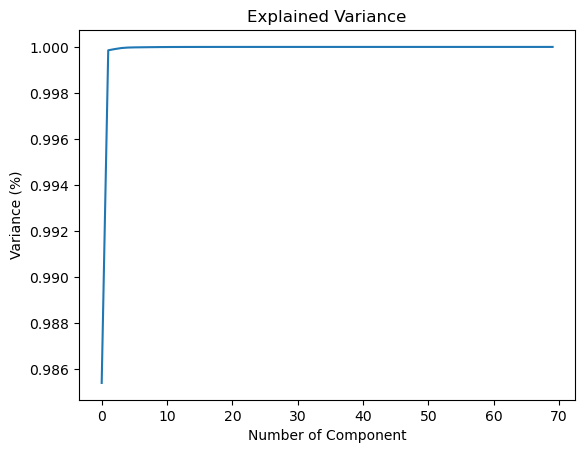

In [124]:
# Getting the optimal number of PCA
from sklearn.decomposition import PCA
pca=PCA()
principalComponent=pca.fit_transform(df)
plt.figure()
plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.xlabel("Number of Component")
plt.ylabel("Variance (%)")
plt.title("Explained Variance")
plt.show()

* After applying PCA (Principal Component Analysis) on the house price prediction dataset, the scree plot reveals a steep upward trend from the beginning. This suggests that each component captures a significant amount of variance in the data. In other words, all features contribute valuable information and are important for building the model. As a result, reducing the dimensionality by eliminating components may not be beneficial, as it would lead to a loss of crucial information. Therefore, PCA indicates that most of the features should be retained to ensure better model performance.

In [125]:
correlation_matrix=df.corr() # calculation correaltion matrix

In [126]:
for i in range(len(correlation_matrix.columns)): # iterate over the correlation matrix and print columns with correlation >0.50
    for j in range(i):
        if abs(correlation_matrix.iloc[i,j])>0.50:
            col1=correlation_matrix.columns[i]
            col2=correlation_matrix.columns[j]
            corr_value=correlation_matrix.iloc[i,j]
            print(f"Correlation between {col1} and {col2} : {corr_value:.2f}")

Correlation between BldgType and MSSubClass : 0.75
Correlation between ExterQual and OverallQual : 0.73
Correlation between BsmtQual and OverallQual : 0.67
Correlation between BsmtQual and ExterQual : 0.65
Correlation between BsmtQual and Foundation : 0.50
Correlation between BsmtFinSF1 and BsmtFinType1 : -0.60
Correlation between BsmtFinSF2 and BsmtFinType2 : -0.72
Correlation between BsmtUnfSF and BsmtFinSF1 : -0.52
Correlation between TotalBsmtSF and OverallQual : 0.53
Correlation between HeatingQC and ExterQual : 0.52
Correlation between 1stFlrSF and TotalBsmtSF : 0.80
Correlation between GrLivArea and OverallQual : 0.59
Correlation between GrLivArea and 1stFlrSF : 0.50
Correlation between GrLivArea and 2ndFlrSF : 0.66
Correlation between BsmtFullBath and BsmtFinSF1 : 0.66
Correlation between FullBath and OverallQual : 0.55
Correlation between FullBath and GrLivArea : 0.63
Correlation between HalfBath and 2ndFlrSF : 0.61
Correlation between BedroomAbvGr and GrLivArea : 0.52
Correla

### Checking correlation between all features

In [127]:
df.corr() # checking correlation

,MSSubClass,MSZoning,LotFrontage,LotArea,Street,LotShape,LandContour,Utilities,LotConfig,LandSlope,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,RoofStyle,RoofMatl,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,GarageType,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,SaleType,SaleCondition,SalePrice,HouseAgeAtSale,RemodAgeAtSale,GarageAgeAtSale
MSSubClass,1.000000,0.035900,-0.401467,-0.139781,-0.024969,0.119289,-0.002940,-0.022844,0.075910,-0.025672,-0.024762,-0.042395,0.746063,0.397161,0.032628,-0.059316,-0.117817,-0.031336,0.008168,0.016178,-0.064686,0.058126,0.076820,-0.005152,0.054925,0.016599,-0.072931,0.041195,-0.054713,-0.140759,-0.250598,0.048009,-0.019458,-0.101774,0.051945,-0.260957,0.310261,0.046474,0.074853,0.003491,-0.002333,0.131608,0.177354,-0.023438,0.281721,-0.012383,0.040380,0.005638,-0.045569,0.090719,0.012301,-0.040110,-0.101369,0.024439,-0.025864,-0.059925,-0.028192,-0.002708,-0.016671,-0.030822,-0.029861,0.014347,-0.046727,-0.013585,0.012464,-0.024940,-0.084284,-0.028746,-0.041968,-0.082451
MSZoning,0.035900,1.000000,-0.120034,-0.034452,0.087654,0.061887,-0.017854,-0.001192,-0.009895,-0.022055,-0.027874,0.044606,0.005690,-0.105315,-0.160099,0.186951,-0.000301,0.005133,-0.019794,-0.195689,0.091101,-0.235174,-0.209086,-0.051366,-0.016238,0.024688,-0.051570,-0.031718,0.039429,-0.046749,-0.094443,0.056866,-0.162866,-0.049523,-0.070818,-0.058083,-0.051671,0.011520,-0.082615,-0.018526,0.007193,-0.198290,-0.133876,-0.016471,0.049434,-0.160914,-0.043200,-0.092383,-0.011349,0.116007,0.167501,-0.157042,-0.183197,-0.089848,-0.069692,-0.100366,-0.015508,-0.153664,0.113526,0.001636,0.003572,-0.002664,0.011520,-0.031496,0.097437,0.009494,-0.166872,0.307520,0.173441,0.262217
LotFrontage,-0.401467,-0.120034,1.000000,0.272915,-0.045180,-0.147452,-0.027015,-0.000243,-0.170545,0.051836,-0.000789,0.004119,-0.453752,0.018412,0.214929,-0.054982,0.166493,0.054169,0.168941,0.152481,-0.021038,0.095195,0.148109,0.040751,0.143691,-0.017115,0.118367,-0.032708,0.062001,0.157038,0.313192,-0.018938,0.075445,0.067898,0.057588,0.367265,0.040172,0.017077,0.302545,0.054143,-0.015107,0.173150,0.043155,0.242211,0.001928,0.144999,0.302583,0.018323,0.214224,-0.236462,-0.212616,0.283562,0.310191,0.051750,0.035197,0.090820,0.091602,0.119304,-0.021449,0.050871,0.045915,0.010704,0.011505,0.006439,-0.031497,0.078103,0.335701,-0.118301,-0.063498,-0.063646
LotArea,-0.139781,-0.034452,0.272915,1.000000,-0.197131,-0.165315,-0.149083,0.010123,-0.121161,0.436868,0.023846,0.022164,-0.205721,-0.033190,0.105806,-0.005636,0.077054,0.149837,0.097137,0.055570,0.014732,-0.011081,0.079775,0.028160,0.232300,-0.061880,0.172091,-0.068954,0.116008,-0.002618,0.223697,0.028158,0.003581,0.049755,0.043856,0.267007,0.046507,0.004779,0.263116,0.158155,0.048046,0.126031,0.014259,0.119690,-0.017784,0.067864,0.190015,-0.018903,0.271364,-0.116799,-0.116326,0.154871,0.156449,0.026851,0.016833,0.015134,0.102809,0.077712,-0.029224,0.023468,0.036101,0.086371,0.086826,0.001205,0.012292,0.034169,0.263843,-0.014832,-0.014709,0.025036
Street,-0.024969,0.087654,-0.045180,-0.197131,1.000000,-0.010224,0.115995,0.001682,0.013960,-0.179360,-0.071657,0.002039,-0.018243,0.023704,0.058823,0.042848,-0.019732,0.008081,0.016023,0.100247,-0.015212,0.035277,0.021961,0.002478,-0.093411,-0.013182,-0.017763,0.061285,-0.054178,0.035229,0.004006,0.007904,0.043211,0.069869,0.021324,0.005143,0.047014,0.007724,0.044121,-0.050524,0.015485,0.046471,0.027628,0.028865,0.013583,0.065669,0.046828,-0.015996,-0.005348,0.001517,-0.008277,-0.020025,-0.010852,-0.006192,-0.006805,0.024521,0.039810,-0.0083

## Transformation

* It is a technique to convert skewed distribution to Normal Distribution by applying Log,Sqrt(Square Root),Box-Cox,Inverse.

<Axes: xlabel='SalePrice', ylabel='Count'>

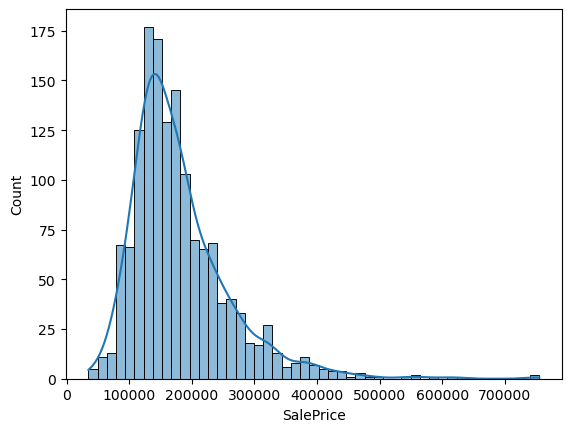

In [128]:
sns.histplot(df.SalePrice,kde=True) # Showing histogram of saleprice

In [129]:
df['SalePrice']=np.log(df['SalePrice']) # Apply log to salee price column

<Axes: xlabel='SalePrice', ylabel='Count'>

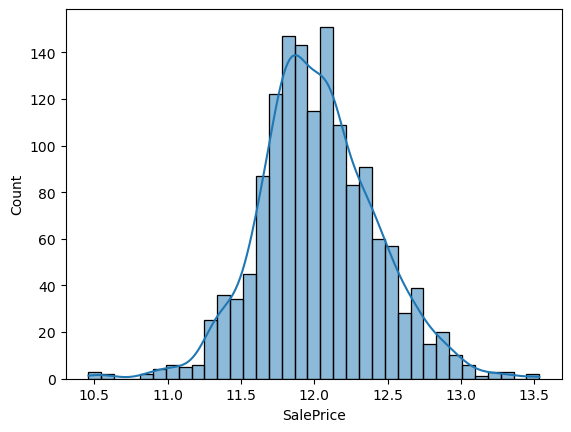

In [130]:
sns.histplot(df.SalePrice,kde=True) # Showing Histogram

* Log transformation was applied only to the SalePrice column because its distribution showed significant improvement after applying the transformation, making it more normally distributed. This helps stabilize variance and make the data more suitable for modeling. For other columns, I did not apply log transformation because their distributions did not show meaningful improvement or change after the transformation. Applying log in such cases would not have provided any added benefit for the model. Therefore, log transformation was selectively applied where it proved useful.

# Scalling

* Scaling is very important of continous features because some model give more priproty to that features which has higest values campare to another features. that's why we use Scaling to make all values into certain range.
 
* Basically there are 2 type of scaling.

1. MinMax Scaling
2. Standardization Scaling

* MinMax Scaling transform all data between 0 to 1  range.
* Standardization Scaling transform all data between -3 to +3 range. it use z-score to tranform data.

In [131]:
df.head()

,MSSubClass,MSZoning,LotFrontage,LotArea,Street,LotShape,LandContour,Utilities,LotConfig,LandSlope,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,RoofStyle,RoofMatl,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,GarageType,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,SaleType,SaleCondition,SalePrice,HouseAgeAtSale,RemodAgeAtSale,GarageAgeAtSale
0,60,3,65.0,8450,1,3,3,0,4,0,2,2,0,5,7,5,1,1,196.0,2,2,2,2,2,0,2,706.0,5,0,150,856.0,1,4,1,4,856,854,0,1710,1,0,2,1,3,1,2,8,6,0,1,1,2,548,2,2,2,0,61,0,0,0,0,0,2,8,4,12.247694,5,5,5.0
1,20,3,80.0,9600,1,3,3,0,2,0,1,2,0,2,6,8,1,1,0.0,1,2,1,2,2,3,0,978.0,5,0,284,1262.0,1,4,1,4,1262,0,0,1262,0,1,2,0,3,1,1,6,6,1,1,1,2,460,2,2,2,298,0,0,0,0,0,0,5,8,4,12.109011,31,31,31.0
2,60,3,68.0,11250,1,0,3,0,4,0,2,2,0,5,7,5,1,1,162.0,2,2,2,2,2,1,2,486.0,5,0,434,920.0,1,4,1,4,920,866,0,1786,1,0,2,1,3,1,2,6,6,1,1,1,2,608,2,2,2,0,42,0,0,0,0,0,9,8,4,12.317167,7,6,7.0
3,70,3,60.0,9550,1,0,3,0,0,0,2,2,0,5,7,5,1,1,0.0,1,2,0,1,3,0,0,216.0,5,0,540,756.0,1,3,1,4,961,756,0,1717,1,0,1,0,3,1,2,7,6,1,5,2,3,642,2,2,2,0,35,272,0,0,0,0,2,8,0,11.849398,91,36,8.0
4,60,3,84.0,14260,1,0,3,0,2,0,2,2,0,5,8,5,1,1,350.0,2,2,2,2,2,2,2,655.0,5,0,490,1145.0,1,4,1,4,1145,1053,0,2198,1,0,2,1,4,1,2,9,6,1,1,1,3,836,2,2,2,192,84,0,0,0,0,0,12,8,4,12.429216,8,8,8.0


In [132]:
original_col=df.columns # store columns name in other variable

In [133]:
original_col

Index(['MSSubClass', 'MSZoning', 'LotFrontage', 'LotArea', 'Street',
       'LotShape', 'LandContour', 'Utilities', 'LotConfig', 'LandSlope',
       'Condition1', 'Condition2', 'BldgType', 'HouseStyle', 'OverallQual',
       'OverallCond', 'RoofStyle', 'RoofMatl', 'MasVnrArea', 'ExterQual',
       'ExterCond', 'Foundation', 'BsmtQual', 'BsmtCond', 'BsmtExposure',
       'BsmtFinType1', 'BsmtFinSF1', 'BsmtFinType2', 'BsmtFinSF2', 'BsmtUnfSF',
       'TotalBsmtSF', 'Heating', 'HeatingQC', 'CentralAir', 'Electrical',
       '1stFlrSF', '2ndFlrSF', 'LowQualFinSF', 'GrLivArea', 'BsmtFullBath',
       'BsmtHalfBath', 'FullBath', 'HalfBath', 'BedroomAbvGr', 'KitchenAbvGr',
       'KitchenQual', 'TotRmsAbvGrd', 'Functional', 'Fireplaces', 'GarageType',
       'GarageFinish', 'GarageCars', 'GarageArea', 'GarageQual', 'GarageCond',
       'PavedDrive', 'WoodDeckSF', 'OpenPorchSF', 'EnclosedPorch', '3SsnPorch',
       'ScreenPorch', 'PoolArea', 'MiscVal', 'MoSold', 'SaleType',
       'SaleConditi

## Min-Max Scalling

* Here we apply Min-Max Scalling because we want positive values.

In [134]:
# We apply min-max scalling
from sklearn.preprocessing import MinMaxScaler
scaler=MinMaxScaler()

In [135]:
df=scaler.fit_transform(df) # appluing scalling to data

In [136]:
df=pd.DataFrame(df,columns=original_col) # Give columns name  after scalling

In [137]:
df.head()

,MSSubClass,MSZoning,LotFrontage,LotArea,Street,LotShape,LandContour,Utilities,LotConfig,LandSlope,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,RoofStyle,RoofMatl,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,GarageType,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,SaleType,SaleCondition,SalePrice,HouseAgeAtSale,RemodAgeAtSale,GarageAgeAtSale
0,0.235294,0.75,0.333333,0.033420,1.0,1.0,1.0,0.0,1.0,0.0,0.250,0.285714,0.0,0.714286,0.666667,0.500,0.2,0.142857,0.240196,0.666667,0.5,0.4,0.666667,0.666667,0.000000,0.4,0.370798,1.0,0.0,0.064212,0.325104,0.2,1.00,1.0,1.0,0.227055,0.469747,0.0,0.259231,0.333333,0.0,0.666667,0.5,0.375,0.333333,0.666667,0.500000,1.0,0.000000,0.2,0.5,0.50,0.512629,0.5,0.5,1.0,0.000000,0.191223,0.000000,0.0,0.0,0.0,0.0,0.090909,1.0,0.8,0.581431,0.036765,0.098361,0.046729
1,0.000000,0.75,0.446970,0.038795,1.0,1.0,1.0,0.0,0.5,0.0,0.125,0.285714,0.0,0.285714,0.555556,0.875,0.2,0.142857,0.000000,0.333333,0.5,0.2,0.666667,0.666667,1.000000,0.0,0.513655,1.0,0.0,0.121575,0.479301,0.2,1.00,1.0,1.0,0.403654,0.000000,0.0,0.174830,0.000000,0.5,0.666667,0.0,0.375,0.333333,0.333333,0.333333,1.0,0.333333,0.2,0.5,0.50,0.430309,0.5,0.5,1.0,0.508532,0.000000,0.000000,0.0,0.0,0.0,0.0,0.363636,1.0,0.8,0.536319,0.227941,0.524590,0.289720
2,0.235294,0.75,0.356061,0.046507,1.0,0.0,1.0,0.0,1.0,0.0,0.250,0.285714,0.0,0.714286,0.666667,0.500,0.2,0.142857,0.198529,0.666667,0.5,0.4,0.666667,0.666667,0.333333,0.4,0.255252,1.0,0.0,0.185788,0.349411,0.2,1.00,1.0,1.0,0.254893,0.476348,0.0,0.273549,0.333333,0.0,0.666667,0.5,0.375,0.333333,0.666667,0.333333,1.0,0.333333,0.2,0.5,0.50,0.568756,0.5,0.5,1.0,0.000000,0.131661,0.000000,0.0,0.0,0.0,0.0,0.727273,1.0,0.8,0.604029,0.051471,0.114754,0.065421
3,0.294118,0.75,0.295455,0.038561,1.0,0.0,1.0,0.0,0.0,0.0,0.250,0.285714,0.0,0.714286,0.666667,0.500,0.2,0.142857,0.000000,0.333333,0.5,0.0,0.333333,1.000000,0.000000,0.0,0.113445,1.0,0.0,0.231164,0.287125,0.2,0.75,1.0,1.0,0.272727,0.415842,0.0,0.260550,0.333333,0.0,0.333333,0.0,0.375,0.333333,0.666667,0.416667,1.0,0.333333,1.0,1.0,0.75,0.600561,0.5,0.5,1.0,0.000000,0.109718,0.824242,0.0,0.0,0.0,0.0,0.090909,1.0,0.0,0.451871,0.669118,0.606557,0.074766
4,0.235294,0.75,0.477273,0.060576,1.0,0.0,1.0,0.0,0.5,0.0,0.250,0.285714,0.0,0.714286,0.777778,0.500,0.2,0.142857,0.428922,0.666667,0.5,0.4,0.666667,0.666667,0.666667,0.4,0.344013,1.0,0.0,0.209760,0.434865,0.2,1.00,1.0,1.0,0.352762,0.579208,0.0,0.351168,0.333333,0.0,0.666667,0.5,0.500,0.333333,0.666667,0.583333,1.0,0.333333,0.2,0.5,0.75,0.782039,0.5,0.5,1.0,0.327645,0.263323,0.000000,0.0,0.0,0.0,0.0,1.000000,1.0,0.8,0.640477,0.058824,0.147541,0.074766


# Model selection Process

In [138]:
x=df.drop('SalePrice',axis=1) # create independent variable
y=df.SalePrice # create dependent variable

In [139]:
from sklearn.model_selection import train_test_split

In [140]:
x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=0.2,random_state=42)

In [141]:
x_train  # checking independet training data

,MSSubClass,MSZoning,LotFrontage,LotArea,Street,LotShape,LandContour,Utilities,LotConfig,LandSlope,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,RoofStyle,RoofMatl,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,GarageType,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,SaleType,SaleCondition,HouseAgeAtSale,RemodAgeAtSale,GarageAgeAtSale
254,0.000000,0.75,0.371212,0.033186,1.0,1.000000,1.000000,0.0,1.00,0.0,0.250,0.285714,0.00,0.285714,0.444444,0.625,0.2,0.142857,0.000000,0.333333,0.75,0.2,0.333333,0.666667,0.000000,0.8,0.484244,1.0,0.000000,0.167808,0.499051,0.2,0.50,1.0,1.00,0.426272,0.000000,0.000000,0.184627,0.333333,0.0,0.333333,0.0,0.375,0.333333,0.333333,0.250000,1.000000,0.000000,0.2,0.5,0.25,0.275023,0.50,0.50,1.0,0.426621,0.000000,0.000000,0.000000,0.000000,0.000000,0.000,0.454545,1.000,0.8,0.389706,0.885246,0.495327
1066,0.235294,0.75,0.287879,0.030555,1.0,0.000000,1.000000,0.0,1.00,0.0,0.250,0.285714,0.00,0.714286,0.555556,0.750,0.2,0.142857,0.000000,0.666667,0.50,0.4,0.666667,0.666667,0.000000,1.0,0.000000,1.0,0.000000,0.342038,0.303456,0.2,0.75,1.0,1.00,0.202262,0.424642,0.000000,0.233044,0.000000,0.0,0.666667,0.5,0.375,0.333333,0.333333,0.416667,1.000000,0.333333,0.2,0.5,0.50,0.355472,0.50,0.50,1.0,0.000000,0.125392,0.000000,0.000000,0.000000,0.000000,0.000,0.363636,1.000,0.8,0.117647,0.262295,0.149533
638,0.058824,0.75,0.348485,0.034948,1.0,1.000000,1.000000,0.0,1.00,0.0,0.125,0.285714,0.00,0.285714,0.444444,0.750,0.2,0.142857,0.000000,0.333333,0.50,0.2,0.000000,0.666667,0.000000,1.0,0.000000,1.0,0.000000,0.340753,0.302317,0.2,0.75,1.0,0.00,0.200957,0.000000,0.000000,0.087038,0.000000,0.0,0.333333,0.0,0.250,0.333333,0.333333,0.166667,1.000000,0.000000,0.2,1.0,0.00,0.000000,0.50,0.50,0.5,0.559727,0.000000,0.496970,0.000000,0.000000,0.000000,0.000,0.363636,1.000,0.8,0.720588,0.967213,0.261682
799,0.176471,0.75,0.295455,0.027577,1.0,1.000000,1.000000,0.0,0.00,0.0,0.125,0.285714,0.00,0.000000,0.444444,0.750,0.2,0.142857,0.308824,0.333333,0.50,0.0,0.666667,0.666667,0.000000,0.0,0.298845,1.0,0.000000,0.069349,0.277630,0.2,1.00,1.0,1.00,0.281427,0.432893,0.000000,0.270158,0.333333,0.0,0.333333,0.5,0.375,0.333333,0.666667,0.416667,1.000000,0.666667,1.0,1.0,0.25,0.224509,0.50,0.50,1.0,0.000000,0.000000,0.800000,0.000000,0.000000,0.000000,0.000,0.454545,1.000,0.8,0.514706,0.950820,0.635514
380,0.176471,0.75,0.219697,0.017294,1.0,1.000000,1.000000,0.0,1.00,0.0,0.250,0.285714,0.00,0.000000,0.444444,0.625,0.2,0.142857,0.000000,0.333333,0.50,0.0,0.333333,0.666667,0.000000,0.6,0.114496,1.0,0.000000,0.345890,0.389670,0.2,0.50,1.0,1.00,0.301000,0.365787,0.000000,0.255652,0.000000,0.0,0.666667,0.0,0.375,0.333333,0.666667,0.333333,1.000000,0.333333,1.0,1.0,0.25,0.288120,0.50,0.50,1.0,0.000000,0.000000,0.733333,0.000000,0.000000,0.000000,0.000,0.363636,1.000,0.8,0.632353,1.000000,0.803738
303,0.000000,0.75,0.371212,0.039730,1.0,1.000000,1.000000,0.0,0.00,0.0,0.250,0.285714,0.00,0.285714,0.444444,0.750,0.2,0.142857,0.000000,0.333333,0.50,0.4,0.333333,0.666667,0.000000,0.0,0.469538,1.0,0.000000,0.000000,0.339537,0.2,0.50,1.0,1.00,0.243584,0.000000,0.000000,0.105501,0.333333,0.0,0.333333,0.0,0.375,0.333333,0.333333,0.250000,1.000000,0.000000,0.2,1.0,0.50,0.516370,0.50,0.50,1.0,0.436860,0.000000,0.000000,0.000000,0.000000,0.000000,0.000,0.545455,1.000,0.0,0.250000,0.573770,0.289720
86,0.235294,0.75,0.765152,0.049597,1.0,0.333333,1.000000,0.0,1.00,0.0,0.250,0.285714,0.00,0.714286,0.555556,0.500,0.2,0.142857,0.000000,0.666667,0.50,0.4,0.666667,0.666667,0.666667,1.0,0.000000,1.0,0.000000,0.292808,0.259780,0.2,1.00,1.0,1.00,0.1522

In [142]:
y_train # Checking dependent training data

254     0.463286
1066    0.529985
638     0.289557
799     0.524456
380     0.420170
303     0.474096
86      0.522592
1385    0.416305
265     0.525384
793     0.606205
1445    0.425253
808     0.495205
1099    0.489150
605     0.575924
701     0.451871
221     0.567892
113     0.594429
548     0.415007
1073    0.494289
174     0.540769
514     0.330833
1350    0.567892
1145    0.472137
965     0.531626
936     0.542356
285     0.504724
1310    0.735678
342     0.298986
1165    0.617807
31      0.472901
873     0.435186
210     0.335850
924     0.579867
405     0.474313
770     0.439800
381     0.547332
889     0.473227
1200    0.390841
188     0.481470
893     0.505316
1327    0.429013
420     0.577980
578     0.465521
83      0.418887
1274    0.449539
48      0.382177
155     0.265745
973     0.537214
1110    0.547765
950     0.425253
1030    0.495307
1435    0.522592
1196    0.597725
1442    0.710449
481     0.771500
179     0.342422
859     0.640477
1213    0.463286
583     0.7258

# Model Creation

# Linear Regression Algorithm

In [143]:
from sklearn.linear_model import LinearRegression # Import linear regression model
LR=LinearRegression() # Call the model

In [144]:
LR.fit(x_train,y_train) # Train the model

,fit_intercept,True
,copy_X,True
,tol,1e-06
,n_jobs,None
,positive,False


In [145]:
y_preLR=LR.predict(x_test) # predict the test data

In [146]:
from sklearn.metrics import r2_score,root_mean_squared_error # import library for model evalution

In [147]:
r1=r2_score(y_test,y_preLR) # chech model performance for testing data

In [148]:
r1

0.8924688089754533

In [149]:
R1=root_mean_squared_error(y_test,y_preLR) # check root mean squared  error for testing data

In [150]:
R1

0.04607892006507911

In [151]:
y_trainLR=LR.predict(x_train) # Predict the training model

In [152]:
r2_score(y_train,y_trainLR) # predict the training data

0.9098888889858014

In [153]:
root_mean_squared_error(y_train,y_trainLR) # check model performance for training data

0.03812487310451514

In [154]:
errorLR=y_test-y_preLR # check the error value

In [155]:
errorLR

892     0.012548
1105   -0.018862
413    -0.015494
522    -0.009037
1036   -0.002319
614    -0.053832
218     0.098601
1160    0.005092
649    -0.010398
887    -0.016232
576     0.002649
1252    0.043179
1061   -0.036855
567     0.026487
1108    0.030463
1113   -0.001097
168    -0.025511
1102    0.004754
1120   -0.000798
67      0.004369
1040    0.018711
453     0.011032
670    -0.004653
1094   -0.005774
192    -0.029023
123    -0.000637
415    -0.022256
277     0.098173
433     0.009063
1317    0.006842
184     0.005956
554     0.035227
1173    0.006237
76      0.053273
906     0.003476
674    -0.019636
1398   -0.003992
374     0.021013
1032   -0.022284
259     0.001755
51     -0.013416
244    -0.060225
1101    0.022678
581    -0.061472
679     0.005445
1132   -0.009642
1220    0.042805
49     -0.010118
591     0.004145
1269    0.037348
1249    0.001077
1138   -0.044198
490    -0.005067
1024    0.141811
811     0.001237
141     0.003776
846     0.000150
925     0.042867
772    -0.0805

<Axes: xlabel='SalePrice', ylabel='Count'>

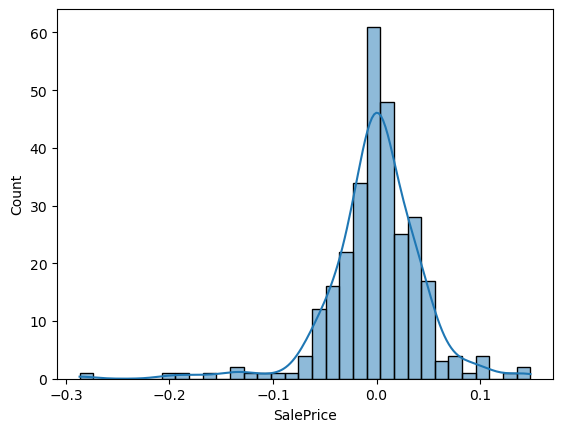

In [156]:
sns.histplot(errorLR,kde=True) # show the error value in plot

## Conclusion:

* In Linear Regression R2_Score for testing data is **89.62%** and for training data is **90.92%** .
* RMSE for testing data is **0.03971** and for training data is **0.03961**.
* Here we can see that the linear regression model show **generalized** model.
* Error also show nearly normal distribution.


# SVM (Support Vector Machine)

In [157]:
from sklearn.svm import SVR # Import the svr algorithm
svr=SVR()
svr.fit(x_train,y_train)

,kernel,'rbf'
,degree,3
,gamma,'scale'
,coef0,0.0
,tol,0.001
,C,1.0
,epsilon,0.1
,shrinking,True
,cache_size,200
,verbose,False
,max_iter,-1


In [158]:
y_preSVR=svr.predict(x_test)

In [159]:
r2_score(y_test,y_preSVR)

0.8412283768303553

In [160]:
root_mean_squared_error(y_test,y_preSVR)

0.055991423178085774

#### Now we apply Hyper-parameter Tuning.
**Hyper-parameter Tuning:-** 
Hyperparameter tuning is the process of optimizing model settings, like learning rate or number of estimators, to improve performance. It involves searching for the best combination of hyperparameters using methods like GridSearchCV or RandomizedSearchCV. The goal is to enhance accuracy and generalization on unseen data.

In [161]:
from sklearn.model_selection import RandomizedSearchCV # import Grid search CV for hyper-parameter tuning

### Here are the reasons for using RandomizedSearchCV :

**Time Efficiency:-** RandomizedSearchCV explores a random subset of the hyperparameter space, making it much faster than GridSearchCV, especially when the search space is large. This is particularly helpful when tuning many parameters or having large datasets.

**Better Coverage:-** It can explore a broader range of hyperparameter values in a shorter amount of time since it samples randomly. This often leads to discovering better combinations of parameters that might be missed with the exhaustive approach of GridSearchCV.

**Computational Efficiency:-** With RandomizedSearchCV, you can specify the number of iterations (combinations) to try. This reduces the computational cost compared to GridSearchCV, which tests all possible combinations.

**Suitable for Large Parameter Space:-** In cases where there are many hyperparameters with a wide range of possible values, GridSearchCV becomes impractical due to the exponential growth in combinations. RandomizedSearchCV avoids this by sampling a fixed number of combinations.

In [162]:
# Define the hyperparameter grid

param_gridSVR = {
    'kernel': ['linear', 'poly', 'rbf'],         # Kernel type
    'C': [0.1, 1, 10, 100],                     # Regularization strength
    'gamma': ['scale', 'auto', 0.001, 0.01, 0.1, 1],  # Kernel coefficient
    'epsilon': [0.01, 0.1, 0.2, 0.5],           # Margin of tolerance
    'degree': [2, 3, 4]                         # Degree for 'poly' kernel
}


In [163]:
# Random search on SVR with 5-fold cross-validation and 100 interation, using R2 score
svr_grid=RandomizedSearchCV(estimator=svr,param_distributions=param_gridSVR,cv=5,scoring='r2',verbose=2,n_jobs=-1,n_iter=100,random_state=25)

In [164]:
svr_grid.fit(x_train,y_train)

Fitting 5 folds for each of 100 candidates, totalling 500 fits


,estimator,SVR()
,param_distributions,"{'C': [0.1, 1, ...], 'degree': [2, 3, ...], 'epsilon': [0.01, 0.1, ...], 'gamma': ['scale', 'auto', ...], ...}"
,n_iter,100
,scoring,'r2'
,n_jobs,-1
,refit,True
,cv,5
,verbose,2
,pre_dispatch,'2*n_jobs'
,random_state,25
,error_score,nan


In [165]:
y_hypsvr=svr_grid.predict(x_test)

In [166]:
r2=r2_score(y_test,y_hypsvr)

In [167]:
r2

0.8938208912955629

In [168]:
R2=root_mean_squared_error(y_test,y_hypsvr)

In [169]:
R2

0.04578830866518011

In [170]:
y_trainhypsvr=svr_grid.predict(x_train)

In [171]:
y_trainhypsvr

array([0.45073742, 0.53011446, 0.33189665, ..., 0.41156287, 0.50201957,
       0.57060717])

In [172]:
r2_score(y_train,y_trainhypsvr)

0.9155200502104218

In [173]:
root_mean_squared_error(y_train,y_trainhypsvr)

0.036914420769741954

In [174]:
errorSVR=y_test-y_preSVR

In [175]:
errorSVR

892     0.087748
1105   -0.027236
413     0.003674
522    -0.020361
1036   -0.030202
614    -0.121614
218     0.116863
1160    0.008520
649    -0.082457
887    -0.018791
576     0.030177
1252    0.067780
1061   -0.079029
567     0.048529
1108   -0.001462
1113    0.015723
168    -0.045355
1102    0.061132
1120   -0.002976
67     -0.033219
1040   -0.005661
453     0.023045
670    -0.039695
1094    0.007480
192    -0.073272
123     0.004436
415    -0.049068
277     0.064923
433    -0.026348
1317    0.028643
184     0.045038
554     0.026904
1173    0.038959
76      0.082374
906    -0.011630
674     0.036055
1398    0.011807
374    -0.009162
1032   -0.034236
259    -0.020261
51     -0.007731
244    -0.090057
1101    0.085966
581    -0.041220
679     0.044419
1132   -0.006802
1220    0.096680
49      0.024063
591     0.035149
1269    0.058604
1249    0.058769
1138   -0.057984
490    -0.042217
1024    0.036940
811    -0.065621
141     0.016690
846    -0.016567
925    -0.013973
772    -0.0744

<Axes: xlabel='SalePrice', ylabel='Count'>

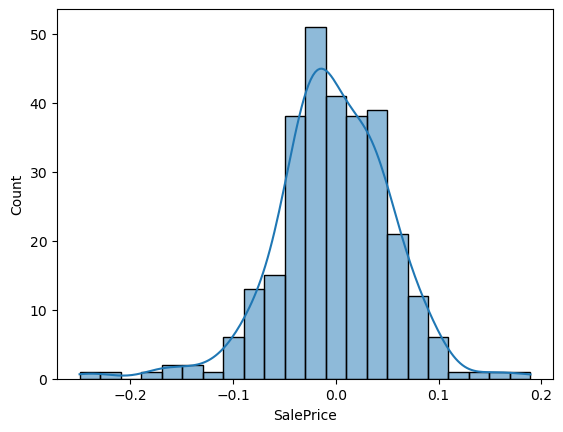

In [176]:
sns.histplot(errorSVR,kde=True)

## Conclusion:

* In SVM R2_Score after Hyper-parameter tuning for testing data is **90.23%** ~ 90% and for training data is **91.35%**.
* RMSE after Hyper-parameter tuning for testing data is **0.03854** and for training data is **0.03865**.
* Here we can see that the SVR model show Generalized model.
* Error also show Nearly normal distribution.

# Desicion Tree

In [177]:
from sklearn.tree import DecisionTreeRegressor
DT=DecisionTreeRegressor(random_state=21)
DT.fit(x_train,y_train)

,criterion,'squared_error'
,splitter,'best'
,max_depth,None
,min_samples_split,2
,min_samples_leaf,1
,min_weight_fraction_leaf,0.0
,max_features,None
,random_state,21
,max_leaf_nodes,None
,min_impurity_decrease,0.0
,ccp_alpha,0.0


In [178]:
y_preDT=DT.predict(x_test)

In [179]:
r2_score(y_test,y_preDT)

0.7671628473037253

In [180]:
root_mean_squared_error(y_test,y_preDT)

0.0678049193855454

In [181]:
y_trainhypDT=DT.predict(x_train)

In [182]:
r2_score(y_train,y_trainhypDT)

1.0

In [183]:
root_mean_squared_error(y_train,y_trainhypDT)

0.0

### Now apply Hyper-Parameter Tuning

In [184]:
# Define hyperparameter grid
param_gridDTR = {
    'criterion': ['squared_error', 'absolute_error'],  # Function to measure the quality of a split
    'splitter': ['best', 'random'],  # Strategy used to split at each node
    'max_depth': [10, 20, 30, 40, 50],  # Maximum depth of the tree
    'min_samples_split': [1,2, 5],  # Minimum number of samples required to split a node
    'min_samples_leaf': [1, 2, 4,5],  # Minimum number of samples required at a leaf node
    'max_features': ['sqrt', 'log2'],  # Number of features to consider when looking for the best split
    'max_leaf_nodes': [10, 20, 30, 50],  # Maximum number of leaf nodes in the tree
}

In [185]:
#  Random search on DTR with 5-fold cross-validation and 100 iterations, using R2 score
DT_grid = RandomizedSearchCV(estimator=DT,param_distributions=param_gridDTR, cv=5, scoring='r2', verbose=2, n_jobs=-1,n_iter=100,random_state=21)

In [186]:
DT_grid.fit(x_train,y_train)

Fitting 5 folds for each of 100 candidates, totalling 500 fits


,estimator,DecisionTreeR...ndom_state=21)
,param_distributions,"{'criterion': ['squared_error', 'absolute_error'], 'max_depth': [10, 20, ...], 'max_features': ['sqrt', 'log2'], 'max_leaf_nodes': [10, 20, ...], ...}"
,n_iter,100
,scoring,'r2'
,n_jobs,-1
,refit,True
,cv,5
,verbose,2
,pre_dispatch,'2*n_jobs'
,random_state,21
,error_score,nan


In [187]:
y_hypDT=DT_grid.predict(x_test)

In [188]:
r3=r2_score(y_test,y_hypDT)

In [189]:
r3

0.7061217248449353

In [190]:
R3=root_mean_squared_error(y_test,y_hypDT)

In [191]:
R3

0.07617611244034878

In [192]:
y_trainhypdt=DT_grid.predict(x_train)

In [193]:
r2_score(y_train,y_trainhypdt)

0.8030739872920136

In [194]:
root_mean_squared_error(y_train,y_trainhypdt)

0.05635997326988891

In [195]:
errorDT=y_test-y_hypDT

In [196]:
errorDT

892     0.045094
1105    0.063335
413     0.008598
522    -0.015968
1036    0.108574
614    -0.057125
218     0.094611
1160   -0.006616
649     0.006880
887    -0.056594
576     0.035521
1252    0.007595
1061   -0.014550
567     0.009425
1108    0.000000
1113    0.000000
168    -0.040765
1102   -0.023245
1120    0.018076
67      0.027172
1040   -0.024256
453     0.029149
670    -0.011131
1094    0.005083
192     0.023898
123    -0.048053
415     0.030366
277     0.074900
433     0.000000
1317    0.051339
184     0.040884
554     0.041478
1173    0.059469
76      0.021673
906     0.006441
674    -0.011415
1398   -0.062045
374     0.017506
1032   -0.138813
259    -0.046772
51      0.007181
244    -0.041485
1101   -0.019800
581    -0.144221
679     0.044704
1132   -0.032885
1220    0.008598
49      0.000000
591    -0.016181
1269   -0.048201
1249   -0.039828
1138    0.052085
490     0.008598
1024    0.067964
811     0.014409
141     0.072759
846    -0.029032
925     0.051556
772    -0.1084

<Axes: xlabel='SalePrice', ylabel='Count'>

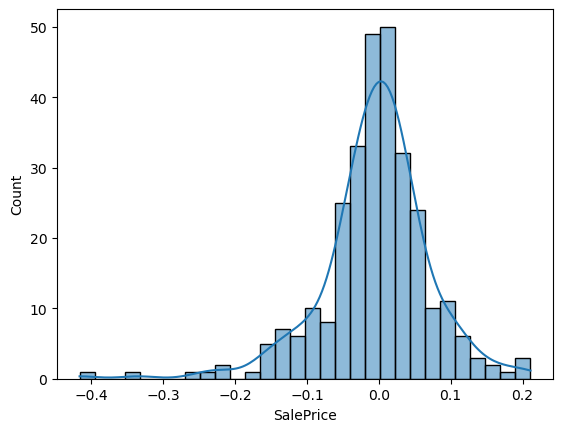

In [197]:
sns.histplot(errorDT,kde=True)

## Conclusion:

* In Decision Tree R2_Score after Hyper-parameter tuning for testing data is **75.48%** and for training data is **84.50%**.
* RMSE after Hyper-parameter tuning for testing data is **0.06105**  and for training data is **0.05174** .
* Here we can see that model show **underfitting** model.
* Error also show skewed in left.

# K-Nearest Neighbours (KNN)

In [198]:
from sklearn.neighbors import KNeighborsRegressor # import KNN call
KNN=KNeighborsRegressor() # call the KNN algorithm
KNN.fit(x_train,y_train) # train the model

,n_neighbors,5
,weights,'uniform'
,algorithm,'auto'
,leaf_size,30
,p,2
,metric,'minkowski'
,metric_params,None
,n_jobs,None


In [199]:
y_preKNN=KNN.predict(x_test)

In [200]:
r2_score(y_test,y_preKNN)

0.796241361624692

In [201]:
root_mean_squared_error(y_test,y_preKNN)

0.06342976157872136

In [202]:
y_trainKNN=KNN.predict(x_train)

In [203]:
r2_score(y_train,y_trainKNN)

0.8400303585103907

In [204]:
root_mean_squared_error(y_train,y_trainKNN)

0.05079699488026899

## Now apply Hyper-Parameter Tuning

In [205]:
# Define param grid
param_gridKNN = {
    'n_neighbors': [1,3, 5, 7],            # Number of neighbors to use for prediction
    'weights': ['uniform', 'distance'],          # Weight function used in prediction
    'algorithm': ['auto', 'ball_tree', 'kd_tree', 'brute'],  # Algorithm used to compute the nearest neighbors
    'leaf_size': [10, 20, 30],          # Leaf size passed to the underlying tree-based algorithms
    'p': [1, 2]                                  # Power parameter for the Minkowski distance (1 for Manhattan, 2 for Euclidean)
}


In [206]:
#  Random search on KNN with 5-fold cross-validation and 100 iterations, using R2 score

KNN_grid = RandomizedSearchCV(estimator=KNN,param_distributions=param_gridKNN,cv=5, scoring='r2', verbose=2, n_jobs=-1,n_iter=100,random_state=21)

In [207]:
KNN_grid.fit(x_train,y_train)

Fitting 5 folds for each of 100 candidates, totalling 500 fits


,estimator,KNeighborsRegressor()
,param_distributions,"{'algorithm': ['auto', 'ball_tree', ...], 'leaf_size': [10, 20, ...], 'n_neighbors': [1, 3, ...], 'p': [1, 2], ...}"
,n_iter,100
,scoring,'r2'
,n_jobs,-1
,refit,True
,cv,5
,verbose,2
,pre_dispatch,'2*n_jobs'
,random_state,21
,error_score,nan


In [208]:
y_hypKNN=KNN_grid.predict(x_test)

In [209]:
r4=r2_score(y_test,y_hypKNN)

In [210]:
r4

0.8318096846291126

In [211]:
R4=root_mean_squared_error(y_test,y_hypKNN)

In [212]:
R4

0.057628266585687794

In [213]:
y_trainhypKNN=KNN_grid.predict(x_train)

In [214]:
r2_score(y_train,y_trainhypKNN)

1.0

In [215]:
root_mean_squared_error(y_train,y_trainhypKNN)

0.0

In [216]:
errorKNN=y_test-y_hypKNN

In [217]:
errorKNN

892     0.060450
1105    0.062805
413     0.018110
522     0.017456
1036   -0.031217
614    -0.034902
218     0.213764
1160   -0.000235
649    -0.004485
887     0.047775
576     0.015032
1252    0.019608
1061   -0.119241
567     0.020174
1108    0.005738
1113   -0.010078
168    -0.012174
1102    0.027207
1120   -0.001415
67      0.016518
1040    0.025981
453     0.031200
670    -0.061330
1094   -0.002481
192    -0.010328
123    -0.057018
415    -0.003458
277     0.110214
433    -0.013144
1317    0.004070
184     0.063501
554     0.048587
1173    0.111066
76      0.065070
906     0.035427
674     0.014263
1398    0.029846
374     0.062454
1032    0.036530
259    -0.034248
51     -0.022805
244    -0.039419
1101   -0.005076
581    -0.075270
679     0.005380
1132   -0.037614
1220    0.025618
49      0.000702
591     0.073181
1269    0.033347
1249    0.003837
1138   -0.009274
490     0.032818
1024    0.113619
811     0.005929
141     0.051019
846     0.008924
925     0.036570
772    -0.0915

<Axes: xlabel='SalePrice', ylabel='Count'>

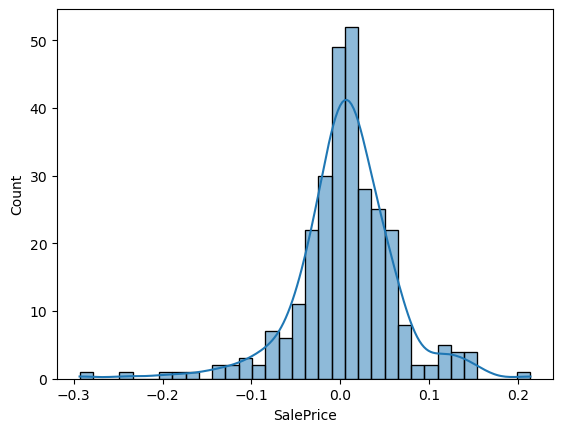

In [218]:
sns.histplot(errorKNN,kde=True)

## Conclusion:

* In KNN R2_Score after Hyper-parameter tuning for testing data is 82.44% and for training data is 100%.
* RMSE after Hyper-parameter tuning for testing data is 0.05166 and for training data is 0.0.
* Here we can see that the model show Undetfitting model.
* But Error show Nearly normal distribution.

# Bagging Algorithm

In [219]:
from sklearn.ensemble import BaggingRegressor # import Bagging Algorithm
BG = BaggingRegressor(random_state=20) # call the BG algorithm
BG.fit(x_train,y_train) # train the model

,estimator,None
,n_estimators,10
,max_samples,1.0
,max_features,1.0
,bootstrap,True
,bootstrap_features,False
,oob_score,False
,warm_start,False
,n_jobs,None
,random_state,20
,verbose,0


In [220]:
y_preBG = BG.predict(x_test)

In [221]:
r2_score(y_test,y_preBG)

0.8679561982353982

In [222]:
root_mean_squared_error(y_test,y_preBG)

0.051061559420932184

In [223]:
y_trainBG = BG.predict(x_train)

In [224]:
r2_score(y_train,y_trainBG)

0.9731939648035378

In [225]:
root_mean_squared_error(y_train,y_trainBG)

0.02079387966836881

## Now apply Hyper-Parameter Tuning

In [226]:
# Define the parameter grid for BaggingRegressor
param_gridBG = {
    'n_estimators': [100, 200],  # Number of base estimators in the ensemble
    'max_samples': [0.5, 0.75, 1.0],     # Proportion of the dataset to draw to train each base estimator
    'max_features': [0.5, 0.75, 1.0],    # Proportion of features to draw to train each base estimator
    'bootstrap': [True, False],          # Whether to use bootstrap samples when building trees                
}

In [227]:
#  Random search on Bagging with 5-fold cross-validation and 100 iterations, using R2 score

BG_grid = RandomizedSearchCV(estimator=BG,param_distributions=param_gridBG,cv=5,scoring='r2',verbose=2, n_jobs=-1,n_iter=100,random_state=42)

In [228]:
BG_grid.fit(x_train,y_train)

Fitting 5 folds for each of 36 candidates, totalling 180 fits


,estimator,BaggingRegres...ndom_state=20)
,param_distributions,"{'bootstrap': [True, False], 'max_features': [0.5, 0.75, ...], 'max_samples': [0.5, 0.75, ...], 'n_estimators': [100, 200]}"
,n_iter,100
,scoring,'r2'
,n_jobs,-1
,refit,True
,cv,5
,verbose,2
,pre_dispatch,'2*n_jobs'
,random_state,42
,error_score,nan


In [229]:
y_hypBG= BG_grid.predict(x_test)

In [230]:
r5=r2_score(y_test,y_hypBG)

In [231]:
r5

0.8929002873054439

In [232]:
R5=root_mean_squared_error(y_test,y_hypBG)

In [233]:
R5

0.045986379286790315

In [234]:
y_trainhypBG = BG_grid.predict(x_train)

In [235]:
r2_score(y_train,y_trainhypBG)

0.999996905687149

In [236]:
root_mean_squared_error(y_train,y_trainhypBG)

0.00022340935009521653

In [237]:
errorBG = y_test - y_hypBG

In [238]:
errorBG

892     0.034803
1105    0.019555
413     0.005209
522     0.027286
1036    0.006414
614    -0.035099
218     0.139327
1160   -0.005647
649    -0.000827
887     0.013196
576    -0.011829
1252    0.025469
1061   -0.094422
567     0.012533
1108    0.008649
1113    0.008532
168    -0.028102
1102   -0.000272
1120    0.000392
67      0.020622
1040   -0.038888
453     0.016035
670    -0.012351
1094    0.016470
192    -0.012186
123    -0.050865
415    -0.013894
277     0.101075
433     0.006662
1317   -0.000349
184     0.003605
554     0.018314
1173    0.031596
76      0.065800
906    -0.009540
674    -0.006357
1398   -0.004082
374     0.018016
1032   -0.002749
259    -0.026727
51     -0.030998
244    -0.037274
1101    0.000095
581    -0.110429
679    -0.011437
1132   -0.065476
1220    0.002530
49      0.001588
591     0.017276
1269    0.007388
1249   -0.011284
1138    0.009413
490    -0.015048
1024   -0.000689
811     0.011290
141     0.010428
846     0.021191
925     0.036411
772    -0.0992

<Axes: xlabel='SalePrice', ylabel='Count'>

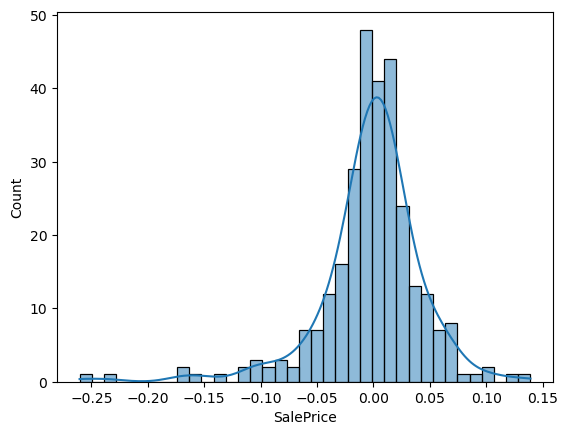

In [239]:
sns.histplot(errorBG,kde=True)

## Conclusion

* In Bagging Algorithm R2_Score after Hyper-parameter tuning for testing data is **88.10%** and for training data is **99.99%**.
* RMSE after Hyper-parameter tuning for testing data is **0.04252** and for training data is **0.0005**.
* Here we can see that the  model show **Underfitting** model.
* Error also show Nearly skewed on left.

# RandomForest Algorithm

In [240]:
from sklearn.ensemble import RandomForestRegressor # import randomforest algorithm
RM = RandomForestRegressor() # store the RM algorithm
RM.fit(x_train,y_train) # train the model

,n_estimators,100
,criterion,'squared_error'
,max_depth,None
,min_samples_split,2
,min_samples_leaf,1
,min_weight_fraction_leaf,0.0
,max_features,1.0
,max_leaf_nodes,None
,min_impurity_decrease,0.0
,bootstrap,True
,oob_score,False


In [241]:
y_preRF = RM.predict(x_test)

In [242]:
r2_score(y_test,y_preRF) 

0.89176615971604

In [243]:
root_mean_squared_error(y_test,y_preRF)

0.04622922343035319

In [244]:
y_trainRF=RM.predict(x_train)

In [245]:
r2_score(y_train,y_trainRF)

0.9816331305900262

In [246]:
root_mean_squared_error(y_train,y_trainRF)

0.01721221664416639

## Now apply Hyper-Parameter Tuning

In [247]:
# define Param grid
param_gridRM={
    'n_estimators': [100, 200, 500],         # Number of trees
    'max_features':  ['sqrt', 'log2'],      # Number of features to consider at each split
    'max_depth': [ 10, 20, 30],       # Maximum depth of the tree
    'min_samples_split': [1,2, 5, 10],               # Minimum number of samples required to split a node
    'min_samples_leaf': [1, 2, 4],                 # Minimum number of samples required at each leaf node
    'bootstrap': [True, False],                    # Whether bootstrap samples are used when building trees
    'criterion': ['squared_error', 'absolute_error'],  # Function to measure the quality of the split
}

In [248]:
#  Random search on Random Forest with 5-fold cross-validation and 100 iterations, using R2 score

RM_grid = RandomizedSearchCV(estimator=RM,param_distributions=param_gridRM,cv=5,scoring= 'r2',verbose=2, n_jobs=-1,n_iter=100,random_state=42)

In [249]:
RM_grid.fit(x_train,y_train)

Fitting 5 folds for each of 100 candidates, totalling 500 fits


,estimator,RandomForestRegressor()
,param_distributions,"{'bootstrap': [True, False], 'criterion': ['squared_error', 'absolute_error'], 'max_depth': [10, 20, ...], 'max_features': ['sqrt', 'log2'], ...}"
,n_iter,100
,scoring,'r2'
,n_jobs,-1
,refit,True
,cv,5
,verbose,2
,pre_dispatch,'2*n_jobs'
,random_state,42
,error_score,nan


In [250]:
y_hypRF = RM_grid.predict(x_test)

In [251]:
r6=r2_score(y_test,y_hypRF)

In [252]:
r6

0.8864499206722819

In [253]:
R6=root_mean_squared_error(y_test,y_hypRF)

In [254]:
R6

0.04735095963807524

In [255]:
y_trainhypRF = RM_grid.predict(x_train)

In [256]:
r2_score(y_train,y_trainhypRF)

0.9999999999597762

In [257]:
root_mean_squared_error(y_train,y_trainhypRF)

8.054915912146929e-07

In [258]:
errorRF=y_test-y_hypRF

In [259]:
errorRF

892     0.032604
1105    0.016176
413     0.005596
522     0.028905
1036    0.008239
614    -0.036347
218     0.142211
1160   -0.004431
649     0.006152
887     0.024730
576     0.011219
1252    0.028418
1061   -0.104155
567     0.012056
1108    0.006907
1113    0.011501
168    -0.025768
1102    0.003025
1120    0.006121
67      0.019322
1040   -0.044623
453     0.004608
670    -0.016112
1094    0.011461
192    -0.015573
123    -0.052718
415    -0.015797
277     0.106373
433     0.004578
1317    0.009813
184     0.011378
554     0.023771
1173    0.016037
76      0.057014
906    -0.007159
674    -0.011723
1398   -0.015527
374     0.017807
1032   -0.001201
259    -0.028300
51     -0.030198
244    -0.036838
1101    0.000266
581    -0.118368
679    -0.009771
1132   -0.057796
1220    0.011186
49     -0.002872
591     0.035493
1269    0.004339
1249   -0.005485
1138   -0.004637
490    -0.018861
1024    0.021756
811     0.009584
141     0.014509
846     0.027906
925     0.031040
772    -0.0997

<Axes: xlabel='SalePrice', ylabel='Count'>

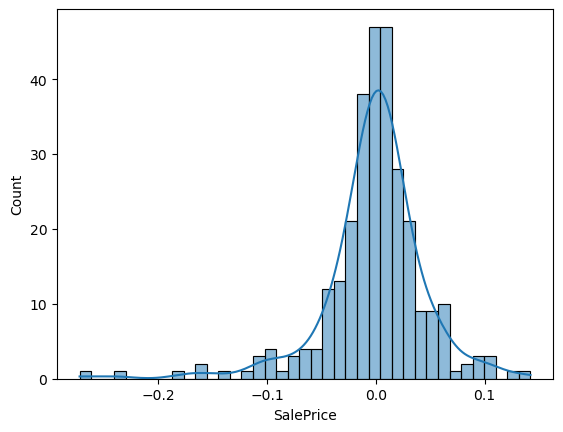

In [260]:
sns.histplot(errorRF,kde=True)

## Conclusion

* In Random Forest R2_Score after Hyper-parameter tuning for testing data is **88.53%** and for training data is **99.67%**.
* RMSE after Hyper-parameter tuning for testing data is **0.04176** and for training data is **0.00745**.
* Here we can see that the  model show **UnderFitting** model.
* Error a show Nearly Normal Distribution.

# Gradiant Boosting Algorithm

In [261]:
from sklearn.ensemble import GradientBoostingRegressor # import the Gradinat boosting Algorithm
GB = GradientBoostingRegressor() # call the Gradinat boosting algorithm
GB.fit(x_train,y_train) # train the data

,loss,'squared_error'
,learning_rate,0.1
,n_estimators,100
,subsample,1.0
,criterion,'friedman_mse'
,min_samples_split,2
,min_samples_leaf,1
,min_weight_fraction_leaf,0.0
,max_depth,3
,min_impurity_decrease,0.0
,init,None


In [262]:
y_preGB = GB.predict(x_test) # predict the testing data

In [263]:
r2_score(y_test,y_preGB)

0.9108195250417376

In [264]:
root_mean_squared_error(y_test,y_preGB)

0.04196333098980339

In [265]:
y_trainGB = GB.predict(x_train)

In [266]:
r2_score(y_train,y_trainGB)

0.9581486938043162

In [267]:
root_mean_squared_error(y_train,y_trainGB)

0.02598206968376253

### Now apply Hyper-Parameter Tuning

In [268]:
#Define param grid
param_gridGB = {
    'n_estimators': [100, 200, 300],     # Number of boosting stages to be run
    'learning_rate': [0.001, 0.01, 0.1],  # Step size shrinkage used in the update to prevent overfitting
    'max_depth': [1,3, 5],                      # Maximum depth of the individual regression estimators
    'min_samples_split': [1,2, 5],                 # Minimum number of samples required to split an internal node
    'min_samples_leaf': [1, 2, 5],                   # Minimum number of samples required to be at a leaf node
    'subsample': [0.6, 0.7, 0.8],               # Fraction of samples to be used for fitting the individual base learners
    'max_features': ['sqrt', 'log2'],                 # Number of features to consider when looking for the best split
}


In [269]:
#  Random search on Gradiant Boosting with 5-fold cross-validation and 100 iterations, using R2 score

GB_grid = RandomizedSearchCV(estimator=GB,param_distributions=param_gridGB,cv=5,scoring= 'r2',verbose=2, n_jobs=-1,n_iter=100,random_state=1)

In [270]:
GB_grid.fit(x_train,y_train)

Fitting 5 folds for each of 100 candidates, totalling 500 fits


,estimator,GradientBoostingRegressor()
,param_distributions,"{'learning_rate': [0.001, 0.01, ...], 'max_depth': [1, 3, ...], 'max_features': ['sqrt', 'log2'], 'min_samples_leaf': [1, 2, ...], ...}"
,n_iter,100
,scoring,'r2'
,n_jobs,-1
,refit,True
,cv,5
,verbose,2
,pre_dispatch,'2*n_jobs'
,random_state,1
,error_score,nan


In [271]:
y_hypGB = GB_grid.predict(x_test)

In [272]:
r7=r2_score(y_test,y_hypGB)

In [273]:
r7

0.9097949235116216

In [274]:
R7=root_mean_squared_error(y_test,y_hypGB)

In [275]:
R7

0.04220370256385551

In [276]:
y_trainhypGB = GB_grid.predict(x_train)

In [277]:
r2_score(y_train,y_trainhypGB)

0.9742731431600135

In [278]:
root_mean_squared_error(y_train,y_trainhypGB)

0.020371011765694065

In [279]:
errorGB = y_test - y_hypGB

In [280]:
errorGB

892     0.036488
1105   -0.019007
413     0.029343
522     0.018805
1036    0.022057
614    -0.007534
218     0.097407
1160   -0.004593
649     0.037238
887    -0.016118
576    -0.011360
1252    0.029621
1061   -0.021178
567     0.034058
1108    0.022020
1113   -0.002203
168    -0.021133
1102    0.003274
1120   -0.002404
67      0.017329
1040   -0.039978
453    -0.003477
670    -0.026375
1094   -0.015802
192    -0.018945
123    -0.044829
415    -0.025914
277     0.099103
433     0.001358
1317    0.008998
184     0.014992
554     0.029886
1173   -0.003502
76      0.051794
906     0.009136
674    -0.028400
1398   -0.005768
374     0.026804
1032   -0.051571
259     0.013720
51     -0.035738
244    -0.039269
1101   -0.000488
581    -0.109611
679     0.006853
1132   -0.021612
1220    0.009882
49      0.000518
591    -0.010778
1269    0.014923
1249   -0.017394
1138   -0.037260
490     0.000460
1024   -0.017205
811    -0.008339
141     0.004898
846     0.020895
925     0.035632
772    -0.0974

<Axes: xlabel='SalePrice', ylabel='Count'>

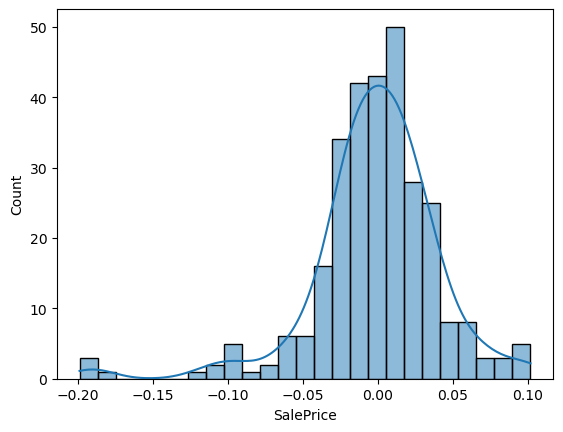

In [281]:
sns.histplot(errorGB,kde=True)

## Conclusion

* In Gradiant Boosting R2_Score after Hyper-parameter tuning for testing data is **88.95%** and for training data is **97.56%**.
* RMSE after Hyper-parameter tuning for testing data is **0.04223** and for training data is **0.01731**.
* Here we can see that the  model show **Underfitting** model.
* Error show Nearly normal distribution.

# AddaBoosting

In [282]:
from sklearn.ensemble import AdaBoostRegressor  # Import Model
AD = AdaBoostRegressor() #call the model
AD.fit(x_train,y_train) # train the model

,estimator,None
,n_estimators,50
,learning_rate,1.0
,loss,'linear'
,random_state,None


In [ ]:
y_preAD = AD.predict(x_test)

In [284]:
r2_score(y_test,y_preAD)

0.8231245255888521

In [285]:
root_mean_squared_error(y_test,y_preAD)

0.05909746783364533

In [286]:
y_trainAD = AD.predict(x_train)

In [287]:
r2_score(y_train,y_trainAD)

0.8514871364499428

In [288]:
root_mean_squared_error(y_train,y_trainAD)

0.04894420410265231

## Now apply Hyper-Parameter Tuning

In [289]:
# Define the hyperparameter grid
param_gridAD = {
    'n_estimators': [100, 200, 500],                # Number of boosting rounds or weak learners
    'learning_rate': [0.01, 0.001, 0.1, 0.2],       # Shrinks the contribution of each weak learner to prevent overfitting
    'loss': ['linear', 'square', 'exponential']    # Loss function to use for the regressor's update step
}


In [290]:
#  Random search on Adda Boosting with 5-fold cross-validation and 100 iterations, using R2 score

AD_grid = RandomizedSearchCV(estimator=AD,param_distributions=param_gridAD,cv=5,scoring= 'r2',verbose=2, n_jobs=-1,n_iter=100,random_state=42)

In [292]:
AD_grid.fit(x_train,y_train)

Fitting 5 folds for each of 36 candidates, totalling 180 fits


,estimator,AdaBoostRegressor()
,param_distributions,"{'learning_rate': [0.01, 0.001, ...], 'loss': ['linear', 'square', ...], 'n_estimators': [100, 200, ...]}"
,n_iter,100
,scoring,'r2'
,n_jobs,-1
,refit,True
,cv,5
,verbose,2
,pre_dispatch,'2*n_jobs'
,random_state,42
,error_score,nan


In [293]:
y_hypAD  = AD_grid.predict(x_test)

In [294]:
r8=r2_score(y_test,y_hypAD)

In [295]:
r8

0.827147421155477

In [296]:
R8=root_mean_squared_error(y_test,y_hypAD)

In [297]:
R8

0.05842153931108138

In [298]:
y_trainhypAD = AD_grid.predict(x_train)

In [299]:
r2_score(y_train,y_trainhypAD)

0.8581933700619526

In [300]:
root_mean_squared_error(y_train,y_trainhypAD)

0.04782637917901184

In [301]:
errorAD = y_test - y_hypAD

In [302]:
errorAD

892     0.082238
1105    0.053325
413     0.047417
522     0.011277
1036    0.037346
614    -0.053014
218     0.149399
1160   -0.034046
649    -0.016381
887     0.074223
576    -0.001365
1252    0.085163
1061   -0.084417
567     0.014232
1108    0.028404
1113    0.028339
168    -0.009609
1102    0.059869
1120    0.043551
67     -0.027321
1040    0.000090
453     0.007639
670    -0.006582
1094    0.079560
192    -0.028802
123    -0.030002
415     0.004451
277     0.096627
433     0.021750
1317    0.059862
184     0.026903
554     0.047656
1173    0.054396
76      0.114696
906     0.005284
674     0.040767
1398    0.017730
374     0.013131
1032    0.028811
259     0.006397
51     -0.020218
244    -0.031239
1101    0.059587
581    -0.085844
679     0.007196
1132   -0.052947
1220    0.071592
49      0.064383
591     0.090698
1269    0.030196
1249    0.044938
1138    0.010093
490     0.003744
1024    0.013973
811    -0.044975
141     0.014369
846     0.026824
925     0.035494
772    -0.0525

<Axes: xlabel='SalePrice', ylabel='Count'>

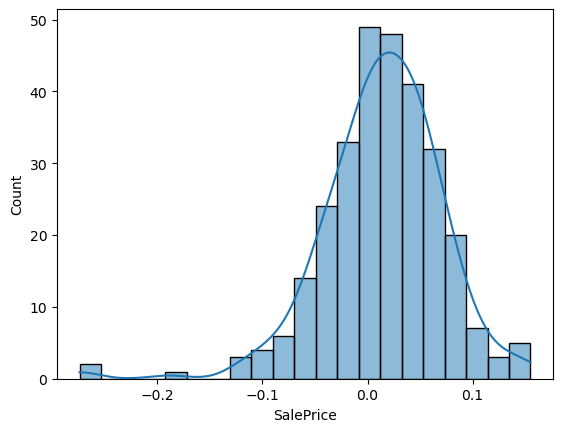

In [303]:
sns.histplot(errorAD,kde=True)

## Conclusion

* In Adda Boosting  R2_Score after Hyper-parameter tuning for testing data is **81.81%** and for training data is **87.10%**.
* RMSE after Hyper-parameter tuning for testing data is **0.05258** and for training data is **0.04720**.
* Here we can see that the  model show **nearly Underfitting** model.
* Error show nearly Normal Distribution.

# Artificial Neural Network (ANN)

In [304]:
from sklearn.neural_network import MLPRegressor #import model
ANN = MLPRegressor(random_state=20) #call the model
ANN.fit(x_train,y_train) # train model

,loss,'squared_error'
,hidden_layer_sizes,"(100,)"
,activation,'relu'
,solver,'adam'
,alpha,0.0001
,batch_size,'auto'
,learning_rate,'constant'
,learning_rate_init,0.001
,power_t,0.5
,max_iter,200
,shuffle,True


In [305]:
y_preANN = ANN.predict(x_test)

In [306]:
r2_score(y_test,y_preANN)

0.8224879500074469

In [307]:
root_mean_squared_error(y_test,y_preANN)

0.059203718338995674

In [308]:
y_trainANN = ANN.predict(x_train)

In [309]:
r2_score(y_train,y_trainANN)

0.8591051700225953

In [310]:
root_mean_squared_error(y_train,y_trainANN)

0.0476723722201363

## Now apply Hyper-Parameter Tuning

In [311]:
# Define the hyperparameter grid
param_gridANN = {
    'hidden_layer_sizes': [(50,), (100,), (100, 50), (150, 100, 50)],  # Varying number of neurons and layers
    'activation': ['tanh', 'relu'],  # Activation functions
    'solver': ['lbfgs', 'sgd', 'adam'],  # Solvers
    'alpha': [0.0001, 0.001, 0.01, 0.1],  # Regularization term (L2 penalty)
    'learning_rate': ['constant', 'invscaling', 'adaptive'],  # Learning rate schedule
    'learning_rate_init': [0.1,0.2,0.3],  # Initial learning rate
    'max_iter': [100, 200, 500, 1000],  # Maximum number of iterations
}

In [312]:
#  Random search on ANN with 5-fold cross-validation and 100 iterations, using R2 score

ANN_grid = RandomizedSearchCV(estimator=ANN,param_distributions=param_gridANN,cv=5,scoring= 'r2',verbose=2, n_jobs=-1,n_iter=100,random_state=42)

In [313]:
ANN_grid.fit(x_train,y_train)

Fitting 5 folds for each of 100 candidates, totalling 500 fits


,estimator,MLPRegressor(random_state=20)
,param_distributions,"{'activation': ['tanh', 'relu'], 'alpha': [0.0001, 0.001, ...], 'hidden_layer_sizes': [(50,), (100,), ...], 'learning_rate': ['constant', 'invscaling', ...], ...}"
,n_iter,100
,scoring,'r2'
,n_jobs,-1
,refit,True
,cv,5
,verbose,2
,pre_dispatch,'2*n_jobs'
,random_state,42
,error_score,nan


In [314]:
y_hypANN = ANN_grid.predict(x_test)

In [315]:
r9=r2_score(y_test,y_hypANN)

In [316]:
r9

0.8970448930297432

In [317]:
R9=root_mean_squared_error(y_test,y_hypANN)

In [318]:
R9

0.04508779648742108

In [319]:
y_trainhypANN = ANN_grid.predict(x_train)

In [320]:
r2_score(y_train,y_trainhypANN)

0.90341700727597

In [321]:
root_mean_squared_error(y_train,y_trainhypANN)

0.039470221524800356

In [322]:
errorANN = y_test- y_hypANN

In [323]:
errorANN

892     0.024234
1105   -0.014230
413    -0.016616
522    -0.023877
1036   -0.008691
614    -0.048253
218     0.097384
1160    0.013614
649    -0.010354
887    -0.002612
576    -0.001859
1252    0.037189
1061   -0.044031
567     0.019921
1108    0.029047
1113   -0.006891
168    -0.026105
1102    0.006589
1120   -0.003343
67     -0.006328
1040    0.007653
453     0.017732
670    -0.004257
1094    0.002412
192    -0.040421
123     0.003580
415    -0.034404
277     0.085629
433     0.004814
1317    0.006232
184     0.003144
554     0.038704
1173   -0.014165
76      0.055423
906    -0.005234
674    -0.020775
1398   -0.003789
374     0.019439
1032   -0.011828
259     0.000093
51     -0.034565
244    -0.059079
1101    0.015628
581    -0.070691
679    -0.002108
1132   -0.003868
1220    0.040505
49     -0.010428
591     0.016158
1269    0.042845
1249    0.001829
1138   -0.053439
490     0.006064
1024    0.056752
811    -0.008076
141     0.004617
846    -0.001533
925     0.026340
772    -0.0719

<Axes: xlabel='SalePrice', ylabel='Count'>

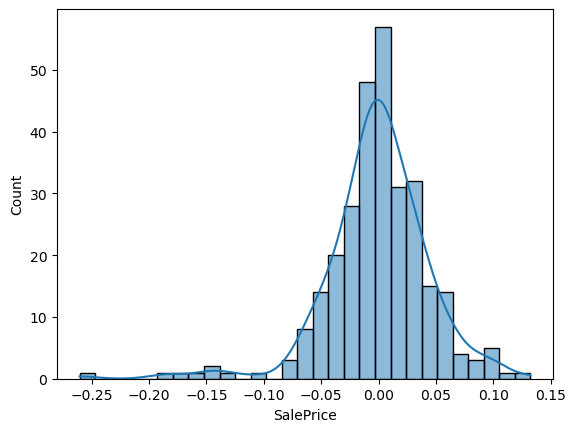

In [324]:
sns.histplot(errorANN,kde=True)

### Conclusion

* In ANN R2_Score after Hyper-parameter tuning for testing data is **88.26%** and for training data is **90.20%**.
* RMSE after Hyper-parameter tuning for testing data is **0.04224** and for training data is **0.04114**.
* Here we can see that the  model show **Generalized** model.
* Error also show Nearly normal distribution.

# Model Comparison Report

In [328]:
# check the all algorithm model perforamnce in table form
# check the Model name, r2_score, root_mean_squer_error
score = pd.DataFrame({"Model":["Linear Regression",'SVM','Decision Tree','KNN','Bagging','Random Forest','Gradiant Boosting',
                              'Ada Boosting','ANN'],
                     "r2_score":[r1*100,r2*100,r3*100,r4*100,r5*100,r6*100,r7*100,r8*100,r9*100],
                     "RMSE":[R1,R2,R3,R4,R5,R6,R7,R8,R9]})
score

,Model,r2_score,RMSE
0,Linear Regression,89.246881,0.046079
1,SVM,89.382089,0.045788
2,Decision Tree,70.612172,0.076176
3,KNN,83.180968,0.057628
4,Bagging,89.290029,0.045986
5,Random Forest,88.644992,0.047351
6,Gradiant Boosting,90.979492,0.042204
7,Ada Boosting,82.714742,0.058422
8,ANN,89.704489,0.045088


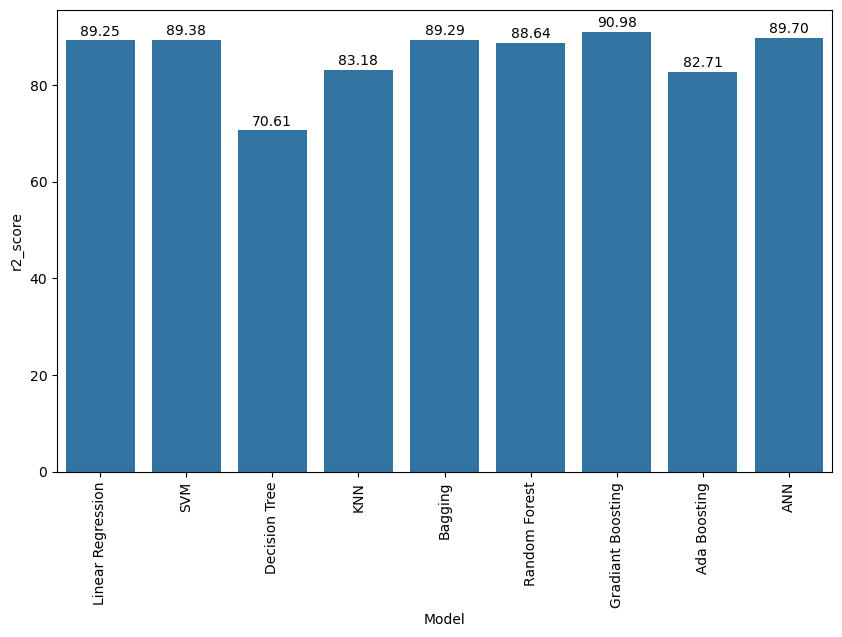

In [330]:
# make bar graph for all model's performance
plt.figure(figsize=(10, 6)) # define the plot size
plt.xticks(rotation = 90) # show the x axis value rotation
a = sns.barplot(x=score.Model, y=score.r2_score, data=score) # create the barplot

for index, value in enumerate(score['r2_score']): # show indivisual bar values show
    a.text(index, value + 1, f'{value:.2f}', ha='center')

# Final Conclusion

* During the analysis, 10 different models were applied to predict house prices. The performance of each model was evaluated using two main metrics: R2 Score and RMSE (Root Mean Squared Error).
* Support Vector Machine (SVM) performed the best, achieving the highest R² score (90.23%) and the lowest RMSE (0.0385). It is the most accurate model in predicting house prices.

* Linear Regression performed admirably with an R² score of 89.62% and RMSE of 0.0397, showing that simpler models can still provide highly accurate predictions.

* Gradient Boosting and Random Forest demonstrated strong performance with R² scores of 88.95% and 88.62% respectively, and relatively low RMSE values. They are reliable models for generalization.

* Bagging Regressor and ANN also performed well, with R² scores of 88.10% and 88.26% respectively, showing that ensemble methods and neural networks can generalize effectively.

* K-Nearest Neighbors (KNN) delivered moderate performance, with an R² score of 82.44% and an RMSE of 0.0517, making it less accurate than other models.

* Decision Tree had the lowest R² score of 75.48% and the highest RMSE of 0.0611, indicating that it struggled the most with generalization.\

***SVM and Linear Regression are the top-performing model and are recommended for deployment due to its accuracy and generalization capabilities.***
***Gradient Boosting, and Random Forest also showed strong performance and are viable alternatives.***
  ***Most of the models demonstrate good generalization, capturing the patterns in the data effectively.***

# Here are some challenges which i faced during create this model:

* During the analysis, 10 different models were applied to predict house prices. The performance of each model was evaluated using two main metrics: R2 Score and RMSE (Root Mean Squared Error).
* Support Vector Machine (SVM) performed the best, achieving the highest R² score (90.23%) and the lowest RMSE (0.0385). It is the most accurate model in predicting house prices.

* Linear Regression performed admirably with an R² score of 89.62% and RMSE of 0.0397, showing that simpler models can still provide highly accurate predictions.

* Gradient Boosting and Random Forest demonstrated strong performance with R² scores of 88.95% and 88.62% respectively, and relatively low RMSE values. They are reliable models for generalization.

* Bagging Regressor and ANN also performed well, with R² scores of 88.10% and 88.26% respectively, showing that ensemble methods and neural networks can generalize effectively.

* K-Nearest Neighbors (KNN) delivered moderate performance, with an R² score of 82.44% and an RMSE of 0.0517, making it less accurate than other models.

* Decision Tree had the lowest R² score of 75.48% and the highest RMSE of 0.0611, indicating that it struggled the most with generalization.\

***SVM and Linear Regression are the top-performing model and are recommended for deployment due to its accuracy and generalization capabilities.***
***Gradient Boosting, and Random Forest also showed strong performance and are viable alternatives.***
  ***Most of the models demonstrate good generalization, capturing the patterns in the data effectively.***